Project: /mediapipe/_project.yaml
Book: /mediapipe/_book.yaml

<link rel="stylesheet" href="/mediapipe/site.css">

# **Object detection model customization guide via Media Pipeline**
#### **(see [media pipeline doc](https://https://developers.google.com/mediapipe) ) **





## Train a custom object detection model with MediaPipe Model Maker

In this colab notebook, you'll learn how to use [MediaPipe Model Maker](https://developers.google.com/mediapipe/solutions/model_maker) to train a custom object detection model to detect dogs.

The Model Maker library uses *transfer learning* to simplify the process of training a TensorFlow Lite model using a custom dataset to use with the [MediaPipe Object Detector task](https://developers.google.com/mediapipe/solutions/vision/object_detector).

<br/><br/>

##### **NOTE: previous tflitemodelmaker code not installing**

*   see INFO at https://developers.google.com/mediapipe/solutions/customization/object_detector
*   See reports (many) https://discuss.tensorflow.org/t/pip-install-tflite-model-maker-fails/16569/18



<table align="left" class="buttons">
  <td>
    <a href="https://colab.research.google.com/github/googlesamples/mediapipe/blob/main/examples/customization/object_detector.ipynb" target="_blank">
      <img src="https://developers.google.com/static/mediapipe/solutions/customization/colab-logo-32px_1920.png" alt="Colab logo"> Original Colab
    </a>
  </td>

  <td>
    <a href="https://github.com/googlesamples/mediapipe/blob/main/examples/customization/object_detector.ipynb" target="_blank">
      <img src="https://developers.google.com/static/mediapipe/solutions/customization/github-logo-32px_1920.png" alt="GitHub logo">
      View Original on GitHub
    </a>
  </td>
</table>

In [ ]:
#@title License information
# Copyright 2023 The MediaPipe Authors.
# Licensed under the Apache License, Version 2.0 (the "License");
#
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

The MediaPipe object detection solution provides several models you can use immediately for machine learning (ML) in your application. However, if you need to detect objects not covered by the provided models, you can customize any of the provided models with your own data and MediaPipe Model Maker. This model modification tool rebuilds the model using data you provide. This method is faster than training a new model and can produce a model that is more useful for your specific application.

The following sections show you how to use Model Maker to retrain a pre-built model for object detection with your own data, which you can then use with the MediaPipe [Object Detector](https://developers.google.com/mediapipe/solutions/vision/object_detector). The example retrains a general purpose object detection model to detect android figurines in images.


**<hr/><hr/>**

#**STEP 1: Setup**

*   List item
*   List item



This section describes key steps for setting up your development environment to retrain a model. These instructions describe how to update a model using [Google Colab](https://colab.research.google.com/), and you can also use Python in your own development environment. For general information on setting up your development environment for using MediaPipe, including platform version requirements, see the [Setup guide for Python](https://developers.google.com/mediapipe/solutions/setup_python).

**Attention:** This MediaPipe Solutions Preview is an early release. [Learn more](https://developers.google.com/mediapipe/solutions/about).

To install the libraries for customizing a model, run the following commands:

In [ ]:
!python --version
!pip install --upgrade pip
!pip install mediapipe-model-maker
!pip install 'keras<3.0.0' mediapipe_model_maker

Python 3.10.12
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 9.4 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 23.1.2
    Uninstalling pip-23.1.2:
      Successfully uninstalled pip-23.1.2
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.9/57.9 kB 3.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 3.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.4/45.4 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 128.0/128.0 kB 9.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.6/35.6 MB 53.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 92.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 589.8/589.8 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 39.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 111.6 MB/s eta 0:00:00
   ━━━━━

Use the following code to import the required Python classes:

In [ ]:
from google.colab import files
import os
import json
import tensorflow as tf
assert tf.__version__.startswith('2')
import cv2

from mediapipe_model_maker import object_detector

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


<hr/><hr/>

# **STEP 2: Prepare data**

Retraining a model for object detection requires a dataset that includes the items, or classes, that you want the completed model to be able to identify. You can do this by trimming down a public dataset to only the classes that are relevant to your usecase, OR compiling your own dataset, OR some combination of both, The dataset can be significantly smaller than what would be required to train a new model. For example, the [COCO](https://cocodataset.org/) dataset used to train many reference models contains hundreds of thousands of images with 91 classes of objects. Transfer learning with Model Maker can retrain an existing model with a smaller dataset and still perform well, depending on your inference accuracy goals. These instructions use a smaller dataset containing 2 types of android figurines, or 2 classes, with 62 total training images.

*  **OUTPUT:**  This will create an instance of the [object_detector.Dataset](https://developers.google.com/mediapipe/api/solutions/python/mediapipe_model_maker/object_detector/Dataset) class for training,  and validation data called **train_data**and **validation_data**. Note you can add on a new test_data object if you have a separate test data directory.



### **Supported dataset formats**
Model Maker Object Detection API supports reading the following dataset formats:


#### ***PASCAL VOC format***

The PASCAL VOC dataset format also has a `images` directory which stores all of the images, however the annotations are split up per image into corresponding xml files in the `Annotations` directory.
```
<dataset_dir>/
  images/
    <file0>.<jpg/jpeg>
    ...
  Annotations/
    <file0>.xml
    ...
```
where the xml files are formatted as:
```
<annotation>
  <filename>file0.jpg</filename>
  <object>
    <name>kangaroo</name>
    <bndbox>
      <xmin>233</xmin>
      <ymin>89</ymin>
      <xmax>386</xmax>
      <ymax>262</ymax>
    </bndbox>
  </object>
  <object>
    ...
  </object>
  ...
</annotation>
```


## **STEP 2.1 setup base_dir which is the path on the mounted drive where the data folder is located**


In [ ]:
from google.colab import drive
drive.mount('/content/drive',  force_remount=True)

Mounted at /content/drive


### **IF YOU ARE ON SHARED FOLDER EXECUTE THE FOLLOWING CELL**

*  ### **REQUIREMENT:** you made a **shortcut** to the base directory inside YOUR drive in a directory called **shared** and in this case the shortcut directory link is called ClothingPartDetection (from SmartFashion/ClothingPartDetection) which contains the folder Data

In [ ]:
base_dir = "/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew"
main_dir = "/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection"

### **IF YOU DATA IS IN YOUR DRIVE**

*  ### **REQUIREMENT:** change the following path to your path and run the next cell





In [ ]:
base_dir = "/content/drive/MyDrive/iLab/SmartFashion/ClothingPartDetection/Data"
main_dir = "/content/drive/MyDrive/iLab/SmartFashion/ClothingPartDetection"

## **STEP 2.2 Go to base_dir directory and load the data assuming it is in Pascal VOC format**

*  ### train, validation and test data in subdirectories in the base_dir
*  ### **REQUIREMENT:** change the path to the directories as necessary for your data directory organization
*  ### **OUTPUT:**  This will create an instance of the [object_detector.Dataset](https://developers.google.com/mediapipe/api/solutions/python/mediapipe_model_maker/object_detector/Dataset) class for training,  and validation data called **train_data**and **validation_data**. Note you can add on a new test_data object if you have a separate test data directory.

In [ ]:
# setup the directory names

export_logs_dir = main_dir +  "/export_logs"   #tensorboard + checkpoint files
export_model_dir = main_dir +  "/export_model"   # last checkpoint + model.tflite files


label_map_file = base_dir + "/ClothingBodyPart_label_map.pbtxt"


test_dir=base_dir + "/test"
train_dir= base_dir + "/train"
validation_dir= base_dir + "/validation"





trainAnnotations_dir= base_dir + "/train/Annotations"
validationAnnotations_dir=base_dir + "/validation/Annotations"
testAnnotations_dir=base_dir + "/test/Annotations"

print("\n\nannotations\n")
print(trainAnnotations_dir)
print(validationAnnotations_dir)
print(testAnnotations_dir)
print("\n\nlabel_map_file")
!cat $label_map_file


print("\n\n\n Annotations train,valid, test \n\n")
%ls -1 {trainAnnotations_dir} | wc -l
%ls -1 {validationAnnotations_dir} | wc -l
%ls -1 {testAnnotations_dir} | wc -l


trainImages_dir= base_dir + "/train/images"
validationImages_dir=base_dir + "/validation/images"
testImages_dir=base_dir + "/test/images"
print("\n\n\n Images train,valid, test \n\n")
%ls -1 {trainAnnotations_dir} | wc -l
%ls -1 {validationAnnotations_dir} | wc -l
%ls -1 {testAnnotations_dir} | wc -l




annotations

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/train/Annotations
/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/validation/Annotations
/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/Annotations


label_map_file
cat: /content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/ClothingBodyPart_label_map.pbtxt: No such file or directory



 Annotations train,valid, test 


858
107
107



 Images train,valid, test 


858
107
107


In [ ]:
# LOAD THE DATA
#load the data from the Pascal VOC

#This uses the MediaPipe API
#see https://developers.google.com/mediapipe/api/solutions/python/mediapipe_model_maker/object_detector/Dataset
train_data = object_detector.Dataset.from_pascal_voc_folder(train_dir, cache_dir="/tmp/od_data/train")
validation_data = object_detector.Dataset.from_pascal_voc_folder(validation_dir, cache_dir="/tmp/od_data/validation")
print("train_data size: ", train_data.size)
print("validation_data size: ", validation_data.size)

train_data size:  858
validation_data size:  107


<hr/><hr/>

# **STEP 3: Retrain model**

Once you have completed preparing your data, you can begin retraining a model to recognize the new objects, or classes, defined by your training data. The instructions below use the data prepared in the previous section to retrain an object detection model



*   This process is resource intensive and can take a few minutes to a few hours depending on your available compute resources.
*  Using a Google Colab environment with standard GPU runtimes, the example retraining below takes about 2~4 minutes for only 3 epochs.


#### ***Set retraining options***


*   see [mediapipe_model_maker.object_detector API](https://developers.google.com/mediapipe/api/solutions/python/mediapipe_model_maker/object_detector)
*  currently [only supports MobileNet](https://developers.google.com/mediapipe/api/solutions/python/mediapipe_model_maker/object_detector/SupportedModels?hl=en) (not EfficientDet)
*  There are a few required settings to run retraining aside from your training dataset: output directory for the model, and the model architecture. Use `HParams` to specify the `export_dir` parameter for the output directory. Use the `SupportedModels` class to specify the model architecture. The object detector solution supports the following model architectures:
* `MobileNet-V2`
* `MobileNet-MultiHW-AVG`

For more advanced customization of training parameters, see the  [Hyperparameters](https://developers.google.com/mediapipe/api/solutions/python/mediapipe_model_maker/object_detector/HParams) section below.

To set the required parameters, use the following code:

## note



*   ## **IMPORTANT NEED: Option 1 below seems to save every 5 epochs a check point.  Is there a way to alter this with this work around**


*   ## **IMPORTANT NEED: need to research how to store the best checkpoint and also how to load back model from a check point.   SEE https://github.com/google/mediapipe/issues/4912**.   Read[ doc](https://developers.google.com/mediapipe/api/solutions/python/mediapipe_model_maker/object_detector/ModelSpec?hl=en) where it says you can pass the cechkpoint_name in the ModelSpec
mediapipe_model_maker.object_detector.ModelSpec(
    downloaded_files: mediapipe_model_maker.face_stylizer.constants.file_util.DownloadedFiles,
    checkpoint_name: str,
    input_image_shape: List[int],
    model_id: str,
    min_level: int,
    max_level: int
)

## **STEP 3- OPTION 1 Train with Tensorboard Callback**

*   Read this https://github.com/google/mediapipe/issues/4923  to see how to add Tensorboard callback....

###### ***IMPORTANT:  the tensorboard log files will be stored in the export_logs_dir specified below and the model files (checkpoint files) will be stored in the export_model_dir specified below***

In [ ]:
#work-around wendy
from mediapipe_model_maker.python.core.utils import file_util
from mediapipe_model_maker.python.core.utils import model_util

epochs = 2000


MOBILENET_V2_I256_FILES = file_util.DownloadedFiles(
    'object_detector/mobilenetv2_i256',
    'https://storage.googleapis.com/tf_model_garden/vision/qat/mobilenetv2_ssd_coco/mobilenetv2_ssd_i256_ckpt.tar.gz',
    is_folder=True,
)
model_spec = object_detector.ModelSpec(
    downloaded_files=MOBILENET_V2_I256_FILES,
    checkpoint_name='ckpt-277200',
    input_image_shape=[256, 256, 3],
    model_id='MobileNetV2',
    min_level=3,
    max_level=7,
    )
hparams = object_detector.HParams(
    batch_size=8,
    learning_rate=0.005,
    epochs= epochs,
    export_dir= export_model_dir
    )
options = object_detector.ModelOptions()

#initialize model
class_names = validation_data.label_names
print("classnames in order " + str(class_names) + "\n\n")
model = object_detector.ObjectDetector(
    model_spec=model_spec,
    label_names = class_names,
    hparams = hparams,
    model_options = options,
)

'''
model = object_detector.ObjectDetector(
    model_spec=model_spec,
    label_names = ["0", "1"],
    hparams = hparams,
    model_options = options,
)
'''

#set callback so will export the Tensorboard Log files

model._callbacks = model_util.get_default_callbacks(export_dir=export_logs_dir)

#you can call _create_and_train_model just like how it is done in ObjectDetector.create.
model._create_and_train_model(
    train_data=train_data,
    validation_data=validation_data,
)


classnames in order ['background', 'Arm', 'Chest', 'Hips', 'Legs', 'Neck', 'Shoulders', 'Waist', 'whole']


Using existing files at /tmp/model_maker/object_detector/mobilenetv2_i256
Model: "retina_net_model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 mobile_net_4 (MobileNet)    {'2': (None, 64, 64, 24   2257984   
                             ),                                  
                              '3': (None, 32, 32, 32             
                             ),                                  
                              '4': (None, 16, 16, 96             
                             ),                                  
                              '5': (None, 8, 8, 320)             
                             , '6': (None, 8, 8, 128             
                             0)}                                 
                                                                

/usr/local/lib/python3.10/dist-packages/keras/src/backend.py:452: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn(


107/107 [==============================] - 87s 309ms/step - total_loss: 17.6627 - cls_loss: 17.1115 - box_loss: 0.0099 - model_loss: 17.6078 - val_total_loss: 20.8304 - val_cls_loss: 20.3004 - val_box_loss: 0.0095 - val_model_loss: 20.7755
Epoch 2/2000
107/107 [==============================] - 21s 197ms/step - total_loss: 11.2414 - cls_loss: 10.6916 - box_loss: 0.0099 - model_loss: 11.1864 - val_total_loss: 10.7695 - val_cls_loss: 10.2276 - val_box_loss: 0.0097 - val_model_loss: 10.7146
Epoch 3/2000
107/107 [==============================] - 20s 184ms/step - total_loss: 4.7716 - cls_loss: 4.2203 - box_loss: 0.0099 - model_loss: 4.7166 - val_total_loss: 4.0144 - val_cls_loss: 3.4682 - val_box_loss: 0.0098 - val_model_loss: 3.9595
Epoch 4/2000
107/107 [==============================] - 19s 173ms/step - total_loss: 2.6341 - cls_loss: 2.0902 - box_loss: 0.0098 - model_loss: 2.5791 - val_total_loss: 2.6525 - val_cls_loss: 2.1041 - val_box_loss: 0.0099 - val_model_loss: 2.5976
Epoch 5/2000


## **STEP 3- OPTION 2 Train with NO Tensorboard Callback**


*   ##### **(DO NOT RUN INFO ONLY)**
*  Use HParams to specify the export_dir parameter for the output directory.**

###### ***IMPORTANT:  the model files (checkpoint files only) will be stored in the export_dir specified below***

In [ ]:
#DO NOT RUN
spec = object_detector.SupportedModels.MOBILENET_MULTI_AVG
hparams = object_detector.HParams(export_dir='exported_model')
options = object_detector.ObjectDetectorOptions(
    supported_model=spec,
    hparams=hparams
)

In [ ]:
#DO NOT RUN
spec = object_detector.SupportedModels.MOBILENET_MULTI_AVG
hparams2 = object_detector.HParams(epochs = 3)
options = object_detector.ObjectDetectorOptions(
    supported_model=spec,
    hparams=hparams2
)

In [ ]:
#DO NOT RUN
model = object_detector.ObjectDetector.create(
    train_data=train_data,
    validation_data=validation_data,
    options=options)

<hr/><hr/>

# **STEP4: LAUNCH Tensorboard if available**



*   using above specified export_logs_dir in step 3-OPTION 1


*   ***IMPORTANT: read https://developers.google.com/mediapipe/api/solutions/python/mediapipe_model_maker/object_detector/ObjectDetector#restore_float_ckpt to understand how to load model from a checkpoint file ---you would use Tensorboard to determine best epoch choose the closes saved checkpoint to reload***




In [ ]:
!kill 4934

In [ ]:
#log_dir = export_logs_dir + "/summaries"
log_dir = "/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/TrainingRuns/Run11/export_logs/summaries"
%load_ext tensorboard
%tensorboard --logdir $log_dir

<IPython.core.display.Javascript object>

#STEPX: Reload model (either "saved", "exported", or checkpoints samed in export_model_dir)

#### **STEP X.1 OPTIONAL reload the model from  a float checkpoint of the model from {hparams.export_dir}/float_ckpt or the export_model_dir/float_ckpt.**

*  see https://developers.google.com/mediapipe/api/solutions/python/mediapipe_model_maker/object_detector/ObjectDetector#restore_float_ckpt
*  this assumes you have created the model above but, not trained it so that would mean only part of option 3.1 up to training is executed

In [ ]:
model.restore_float_ckpt()

Using existing files at /tmp/model_maker/object_detector/mobilenetv2_i256
Model: "retina_net_model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 mobile_net_2 (MobileNet)    {'2': (None, 64, 64, 24   2257984   
                             ),                                  
                              '3': (None, 32, 32, 32             
                             ),                                  
                              '4': (None, 16, 16, 96             
                             ),                                  
                              '5': (None, 8, 8, 320)             
                             , '6': (None, 8, 8, 128             
                             0)}                                 
                                                                 
 fpn_2 (FPN)                 {'5': (None, 8, 8, 128)   149056    
                             , '4': (Non

#### **STEP X.2 OPTIONAL reload the model from a checkpoint file stored in export_logs_dir/checkpoint after examining the Tensorboard graphs to find best point in training**

*  see https://developers.google.com/mediapipe/api/solutions/python/mediapipe_model_maker/object_detector/ObjectDetector#restore_float_ckpt *italicized text*

In [ ]:
#JUST A GUESS NOT COMPLETED
model._model = tf.keras.load_model(<path_to_best_saved_model>, compile=False)

SyntaxError: invalid syntax (<ipython-input-11-e7e890653bca>, line 2)

#### **STEP X.3 OPTIONAL reload the model from a checkpoint file stored in export_logs_dir/checkpoint after examining the Tensorboard graphs to find best point in training**

In [ ]:
# GETTING STRUCTURE OF MODEL work-around wendy
from mediapipe_model_maker.python.core.utils import file_util
from mediapipe_model_maker.python.core.utils import model_util

epochs = 3


MOBILENET_V2_I256_FILES = file_util.DownloadedFiles(
    'object_detector/mobilenetv2_i256',
    'https://storage.googleapis.com/tf_model_garden/vision/qat/mobilenetv2_ssd_coco/mobilenetv2_ssd_i256_ckpt.tar.gz',
    is_folder=True,
)
model_spec = object_detector.ModelSpec(
    downloaded_files=MOBILENET_V2_I256_FILES,
    checkpoint_name='/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/TrainingRuns/Run11/export_logs/checkpoint/checkpoint',
    input_image_shape=[256, 256, 3],
    model_id='MobileNetV2',
    min_level=3,
    max_level=7,
    )
hparams = object_detector.HParams(
    batch_size=8,
    learning_rate=0.3,
    epochs= epochs,
    export_dir= export_model_dir
    )
options = object_detector.ModelOptions()

#initialize model
model = object_detector.ObjectDetector(
    model_spec=model_spec,
    label_names = ["0", "1"],
    hparams = hparams,
    model_options = options,
)

#set callback so will export the Tensorboard Log files

model._callbacks = model_util.get_default_callbacks(export_dir=export_logs_dir)







```
# This is formatted as code  ONE is a ObjectDetector (need this object for , ._model = an ObjectDetectorModel) and the other ObjectDetectorModel  ( load_checkpoint)
```

model._model.load_checkpoint("path to our checkpoint") #????

<hr/><hr/>

# **STEP5: Evaluate the model performance**

After training the model, evaluate it on validation dataset and print the loss and coco_metrics. The most important metric for evaluating the model performance is typically the "AP" coco metric for Average Precision.

In [ ]:
loss, coco_metrics = model.evaluate(validation_data, batch_size=4)
print(f"Validation loss: {loss}")
print(f"Validation coco metrics: {coco_metrics}")

27/27 [==============================] - 4s 37ms/step - total_loss: 0.9708 - cls_loss: 0.6565 - box_loss: 0.0052 - model_loss: 0.9168


/usr/local/lib/python3.10/dist-packages/keras/src/engine/functional.py:642: UserWarning: Input dict contained keys ['6'] which did not match any model input. They will be ignored by the model.
  inputs = self._flatten_to_reference_inputs(inputs)


creating index...
index created!
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.60s).
Accumulating evaluation results...
DONE (t=0.17s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.637
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.274
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.325
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.370
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.484
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.485
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.000
 Av

<hr/><hr/>

# **STEP 6: Export model**

After creating the model, convert and export it to a Tensorflow Lite model format for later use on an on-device application. The export also includes model metadata, which includes the label map.



*   Uses export_model_dir specified in STEP 3-OPTION 1
*   If you ran STEP3-OPTION 2 then it is storing it on the local VM drive in the folder exported_model and you should save it somewhere




In [ ]:
model.export_model()
!ls exported_model


Exporting a floating point model


/usr/local/lib/python3.10/dist-packages/keras/src/engine/functional.py:642: UserWarning: Input dict contained keys ['6'] which did not match any model input. They will be ignored by the model.
  inputs = self._flatten_to_reference_inputs(inputs)


ls: cannot access 'exported_model': No such file or directory


In [ ]:
#run to export labels will store in default file labels.txt
model.export_labels(export_model_dir)

#### run the following if you want to download the tflite file to YOUR machine


*   Assumes it is located in export_mode_dir/model.tflite (see step 3-Option1)



In [ ]:
files.download(export_model_dir + '/model.tflite')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<hr/><hr/>

# **STEP 7 OPTIONAL: Model quantization  (DO NOT RUN here for information)**

Model quantization is a model modification technique that can reduce the model size and improve the speed of predictions with only a relatively minor decrease in accuracy.

This section of the guide explains how to apply quantization to your model. Model Maker supports two forms of quantization for object detector:
1. Quantization Aware Training: 8 bit integer precision for CPU usage
2. Post-Training Quantization: 16 bit floating point precision for GPU usage

### Quantization aware training (int8 quantization)
Quantization aware training (QAT) is a fine-tuning step which happens after fully training your model. This technique further tunes a model which emulates inference time quantization in order to account for the lower precision of 8 bit integer quantization. For on-device applications with a standard CPU, use Int8 precision. For more information, see the [TensorFlow Lite](https://www.tensorflow.org/model_optimization/guide/quantization/training) documentation.

To apply quantization aware training and export to an int8 model, create a `QATHParams` configuration and run the `quantization_aware_training` method. See the **Hyperparameters** section below on detailed usage of `QATHParams`.

In [ ]:
qat_hparams = object_detector.QATHParams(learning_rate=0.3, batch_size=4, epochs=10, decay_steps=6, decay_rate=0.96)
model.quantization_aware_training(train_data, validation_data, qat_hparams=qat_hparams)
qat_loss, qat_coco_metrics = model.evaluate(validation_data)
print(f"QAT validation loss: {qat_loss}")
print(f"QAT validation coco metrics: {qat_coco_metrics}")

AttributeError: 'NoneType' object has no attribute 'convert_to_qat'

The QAT step often requires multiple runs to tune the parameters of training. To avoid having to rerun model training using the `create` method, use the `restore_float_ckpt` method to restore the model state back to the fully trained float model(After running the `create` method) in order to run QAT again.

In [ ]:
new_qat_hparams = object_detector.QATHParams(learning_rate=0.9, batch_size=4, epochs=15, decay_steps=5, decay_rate=0.96)
model.restore_float_ckpt()
model.quantization_aware_training(train_data, validation_data, qat_hparams=new_qat_hparams)
qat_loss, qat_coco_metrics = model.evaluate(validation_data)
print(f"QAT validation loss: {qat_loss}")
print(f"QAT validation coco metrics: {qat_coco_metrics}")

Finally, us the `export_model` to export to an int8 quantized model. The `export_model` function will automatically export to either float32 or int8 model depending on whether `quantization_aware_training` was run.

In [ ]:
model.export_model('model_int8_qat.tflite')
!ls -lh exported_model
files.download('exported_model/model_int8_qat.tflite')

### Post-training quantization (fp16 quantization)

Post-training model quantization is a model modification technique that can reduce the model size and improve the speed of predictions with only a relatively minor decrease in accuracy. This approach reduces the size of the data processed by the model, for example by transforming 32-bit floating point numbers to 16-bit floats. Float16 quantization is reccomended for GPU usage. For more information, see the [TensorFlow Lite](https://www.tensorflow.org/model_optimization/guide/quantization/post_training) documentation.

First, import the MediaPipe Model Maker quantization module:

In [ ]:
from mediapipe_model_maker import quantization

Define a QuantizationConfig object using the `for_float16()` class method. This configuration modifies a trained model to use 16-bit floating point numbers instead of 32-bit floating point numbers. You can further customize the quantization process by setting additional parameters for the QuantizationConfig class.

In [ ]:
quantization_config = quantization.QuantizationConfig.for_float16()

Export the model using the additional quantization_config object to apply post-training quantization. Note that if you previously ran `quantization_aware_training`, you must first convert the model back to a float model by using `restore_float_ckpt`.

In [ ]:
model.restore_float_ckpt()
model.export_model(model_name="model_fp16.tflite", quantization_config=quantization_config)
!ls -lh exported_model
files.download('exported_model/model_fp16.tflite')

<hr/><hr/>

# **STEP 8: (INFO ONLY) Hyperparameters  - how to alter in model creation**
You can further customize the model using the ObjectDetectorOptions class, which has three parameters for `SupportedModels`, `ModelOptions`, and `HParams`.

Use the `SupportedModels` enum class to specify the model architecture to use for training. The following model architectures are supported:
* MOBILENET_V2
* MOBILENET_V2_I320
* MOBILENET_MULTI_AVG
* MOBILENET_MULTI_AVG_I384

Use the `HParams` class to customize other parameters related to training and saving the model:
* `learning_rate`: Learning rate to use for gradient descent training. Defaults to 0.3.
* `batch_size`: Batch size for training. Defaults to 8.
* `epochs`: Number of training iterations over the dataset. Defaults to 30.
* `cosine_decay_epochs`: The number of epochs for cosine decay learning rate. See [tf.keras.optimizers.schedules.CosineDecay](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/schedules/CosineDecay) for more info. Defaults to None, which is equivalent to setting it to `epochs`.
* `cosine_decay_alpha`: The alpha value for cosine decay learning rate. See [tf.keras.optimizers.schedules.CosineDecay](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/schedules/CosineDecay) for more info. Defaults to 1.0, which means no cosine decay.

Use the `ModelOptions` class to customize parameters related to the model itself:
* `l2_weight_decay`: L2 regularization penalty used in [tf.keras.regularizers.L2](https://www.tensorflow.org/api_docs/python/tf/keras/regularizers/L2). Defaults to 3e-5.

Uset the `QATHParams` class to customize training parameters for Quantization Aware Training:
* `learning_rate`: Learning rate to use for gradient descent QAT. Defaults to 0.3.
* `batch_size`: Batch size for QAT. Defaults to 8
* `epochs`: Number of training iterations over the dataset. Defaults to 15.
* `decay_steps`: Learning rate decay steps for Exponential Decay. See [tf.keras.optimizers.schedules.ExponentialDecay](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/schedules/ExponentialDecay) for more information. Defaults to 8
* `decay_rate`: Learning rate decay rate for Exponential Decay. See [tf.keras.optimizers.schedules.ExponentialDecay](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/schedules/ExponentialDecay) for more information. Defaults to 0.96.

<hr/><hr/>

# **STEP 9: (INFO ONLY) Benchmarking**
Below is a summary of Tensorflow's benchmarking results for the supported model architectures in MediaPipe. These models were trained and evaluated on the same android figurines dataset as this notebook. When considering the model benchmarking results, there are a few important caveats to keep in mind:
* The android figurines dataset is a small and simple dataset with 62 training examples and 10 validation examples. Since the dataset is quite small, metrics may vary drastically due to variances in the training process. This dataset was provided for demo purposes and it is recommended to collect more data samples for better performing models.
* The float32 models were trained with the default HParams, and the QAT step for the int8 models was run with `QATHParams(learning_rate=0.1, batch_size=4, epochs=30, decay_rate=1)`.
* For your own dataset, you will likely need to tune values for both HParams and QATHParams in order to achieve the best results. See the [Hyperparameters](#hyperparameters) section above for more information on configuring training parameters.
* All latency numbers are benchmarked on the Pixel 6.


<table>
<thead>
<col>
<col>
<colgroup span="2"></colgroup>
<colgroup span="2"></colgroup>
<colgroup span="2"></colgroup>
<tr>
<th rowspan="2">Model architecture</th>
<th rowspan="2">Input Image Size</th>
<th colspan="2" scope="colgroup">Test AP</th>
<th colspan="2" scope="colgroup">CPU Latency</th>
<th colspan="2" scope="colgroup">Model Size</th>
</tr>
<tr>
<th>float32</th>
<th>QAT int8</th>
<th>float32</th>
<th>QAT int8</th>
<th>float32</th>
<th>QAT int8</th>
</tr>
</thead>
<tbody>
<tr>
<td>MobileNetV2</td>
<td>256x256</td>
<td>88.4%</td>
<td>73.5%</td>
<td>48ms</td>
<td>16ms</td>
<td>11MB</td>
<td>3.2MB</td>
</tr>
<tr>
<td>MobileNetV2 I320</td>
<td>320x320</td>
<td>89.1%</td>
<td>75.5%</td>
<td>75ms</td>
<td>33.38ms</td>
<td>10MB</td>
<td>3.3MB</td>
</tr>
<tr>
<td>MobileNet MultiHW AVG</td>
<td>256x256</td>
<td>88.5%</td>
<td>70.0%</td>
<td>56ms</td>
<td>19ms</td>
<td>13MB</td>
<td>3.6MB</td>
</tr>
<tr>
<td>MobileNet MultiHW AVG I384</td>
<td>384x384</td>
<td>92.7%</td>
<td>73.4%</td>
<td>238ms</td>
<td>41ms</td>
<td>13MB</td>
<td>3.6MB</td>
</tr>

</tbody>
</table>



<hr/><hr/>

# **STEP 10: Prediction**

### see api for details on running inference below is done on the TFLITE model that is loaded from a file

https://developers.google.com/mediapipe/solutions/vision/object_detector/python#image



##**STEP 10.0 Preparation** --IF you have not yet excuted steps 1 + 2 do that

## **STEP 10.1 Setup:** import modules needs, define some visualization functions and load model from tflite file if not done

In [ ]:
#grab the vector of string class names
class_names = validation_data.label_names
print("order of class names --indicating index values (corresponding class index)")
print(class_names)
print("\n\n\n")

order of class names --indicating index values (corresponding class index)
['background', 'Arm', 'Chest', 'Hips', 'Legs', 'Neck', 'Shoulders', 'Waist', 'whole']






### Loat the model

In [ ]:
# STEP 1: Import the necessary modules.
import numpy as np
import mediapipe as mp
import cv2
from google.colab.patches import cv2_imshow
from mediapipe.tasks import python
from mediapipe.tasks.python import vision

model_tflite_file = export_model_dir + "/model.tflite"
# STEP 2: Create an ObjectDetector object.
#base_options = python.BaseOptions(model_asset_path='efficientdet.tflite')
base_options = python.BaseOptions(model_asset_path=model_tflite_file)

options = vision.ObjectDetectorOptions(base_options=base_options,
                                       score_threshold=0.5)
detector = vision.ObjectDetector.create_from_options(options)

### import modules AND create visualization function will use for drawing the predicted bounding boxes on an image, and returns this augmented image

In [ ]:
#We implemented some functions to visualize the object detection results. <br/> Run the following cell to activate the functions.
import cv2
import numpy as np

MARGIN = 10  # pixels
ROW_SIZE = 10  # pixels
FONT_SIZE = 1
FONT_THICKNESS = 1
TEXT_COLOR = (255, 0, 0)  # red


def visualize(
    image,
    detection_result
) -> np.ndarray:
  """Draws bounding boxes on the input image and return it.
  Args:
    image: The input RGB image.
    detection_result: The list of all "Detection" entities to be visualize.
  Returns:
    Image with bounding boxes.
  """
  for detection in detection_result.detections:
    # Draw bounding_box
    bbox = detection.bounding_box
    start_point = bbox.origin_x, bbox.origin_y
    end_point = bbox.origin_x + bbox.width, bbox.origin_y + bbox.height
    cv2.rectangle(image, start_point, end_point, TEXT_COLOR, 3)

    # Draw label and score
    category = detection.categories[0]
    category_name = category.category_name
    probability = round(category.score, 2)
    result_text = category_name + ' (' + str(probability) + ')'
    text_location = (MARGIN + bbox.origin_x,
                     MARGIN + ROW_SIZE + bbox.origin_y)
    cv2.putText(image, result_text, text_location, cv2.FONT_HERSHEY_PLAIN,
                FONT_SIZE, TEXT_COLOR, FONT_THICKNESS)

  return image

##**STEP 10.2 OPTION PREDICTION ON A SINGLE IMAGE** (uploaded from your local machine)

### Load an image from your local machine

In [ ]:
from google.colab import files
uploaded = files.upload()

for filename in uploaded:
  content = uploaded[filename]
  with open(filename, 'wb') as f:
    f.write(content)

if len(uploaded.keys()):
  IMAGE_FILE = next(iter(uploaded))
  print('Uploaded file:', IMAGE_FILE)

Saving body1.jpg to body1.jpg
Uploaded file: body1.jpg


### Run prediction on loaded image

In [ ]:
# STEP 1: Load the input image.
image = mp.Image.create_from_file(IMAGE_FILE)

# STEP 2: Detect objects in the input image.
detection_result = detector.detect(image)

# STEP 3: Process the detection result. In this case, visualize it.
image_copy = np.copy(image.numpy_view())
annotated_image = visualize(image_copy, detection_result)
rgb_annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
cv2_imshow(rgb_annotated_image)

NameError: name 'IMAGE_FILE' is not defined

##**STEP 10.3 OPTION PREDICTION ON A DIRECTORY OF IMAGES** (in drive folder)

### Plot results of running through the images in a directory and run predictions on each and display the results


In [ ]:
!ls $test_dir
test_img_dir = test_dir + "/images"
!ls $test_img_dir

Annotations  images
dress113_jpeg.rf.b66c9b405e119f911d188475594ab0bb.jpg
dress115_jpeg.rf.6836079ed8f5dff426683059ca8beceb.jpg
dress124_jpeg.rf.5c3d1acf043073206525fc48ea56cf80.jpg
dress127_jpeg.rf.b0442e4ba5c8857094b9f47701cf8958.jpg
dress146_jpeg.rf.7733a303b4506953eac74b21327cb53b.jpg
dress17_jpeg.rf.90ad152ede226b5a038227eaea69724b.jpg
dress18_jpeg.rf.01fbe2bcb54a7e5b8da9a81e1c2cacce.jpg
dress24_jpeg.rf.22f30018f8c9757d5bf2f7d93109c89c.jpg
dress26_jpeg.rf.74a2eca619c469a12f71864503fbfcc9.jpg
dress36_jpeg.rf.1610ee80ac633abe3d19e35a816633b2.jpg
dress48_jpeg.rf.eb0608b65a1041bdd199b8ea2c7736a2.jpg
dress84_jpeg.rf.76593a09120c87225aee2668eb06ec0b.jpg
dress89_jpeg.rf.d68742cea4edfc13bcb82eaf5bb0b14c.jpg
dress93_jpeg.rf.f6051848898ca68cf8c6e55c5897c901.jpg
hips8_02_jpeg.rf.4e957c9e95b18780407d801c9371398a.jpg
hips9_01_jpeg.rf.f1aee207c69dbd2632d884467c7628ee.jpg
jacket23_jpeg.rf.d7f11a316282871ae842152ef1fbe893.jpg
jacket32_jpeg.rf.df5b87df6520a28635c92ded294cddd6.jpg
jacket33_jpeg.rf.

In [ ]:
import pathlib

# go to the test_directory and create array of image_filenames_array of the files in that directory
data_dir = pathlib.Path(test_dir + "/images")
print(data_dir)
image_filenames_array = list(data_dir.glob('*'))
print(image_filenames_array)
for image_filename in image_filenames_array:
  print(str(image_filename))

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images
[PosixPath('/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts91_jpeg.rf.5ea5882fc056211c7752cc8325124289.jpg'), PosixPath('/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/hips8_02_jpeg.rf.4e957c9e95b18780407d801c9371398a.jpg'), PosixPath('/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/sleeveWidth8_01_jpeg.rf.a505274ff206e84267a2af565aa843c5.jpg'), PosixPath('/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress18_jpeg.rf.01fbe2bcb54a7e5b8da9a81e1c2cacce.jpg'), PosixPath('/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants98_jpeg.rf.a3307d00e053851f669691c99f3449ae.jpg'), PosixPath('/content/drive/MyDrive/ObjectDetection/SmartFashi

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images
[PosixPath('/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts91_jpeg.rf.5ea5882fc056211c7752cc8325124289.jpg'), PosixPath('/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/hips8_02_jpeg.rf.4e957c9e95b18780407d801c9371398a.jpg'), PosixPath('/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/sleeveWidth8_01_jpeg.rf.a505274ff206e84267a2af565aa843c5.jpg'), PosixPath('/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress18_jpeg.rf.01fbe2bcb54a7e5b8da9a81e1c2cacce.jpg'), PosixPath('/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants98_jpeg.rf.a3307d00e053851f669691c99f3449ae.jpg'), PosixPath('/content/drive/MyDrive/ObjectDetection/SmartFashi

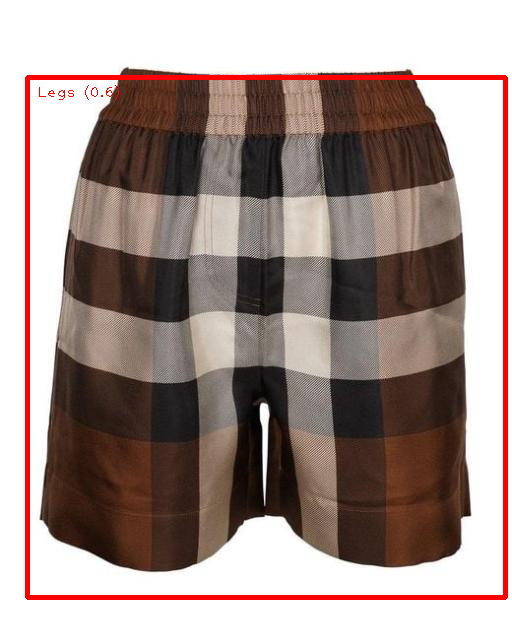

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/hips8_02_jpeg.rf.4e957c9e95b18780407d801c9371398a.jpg


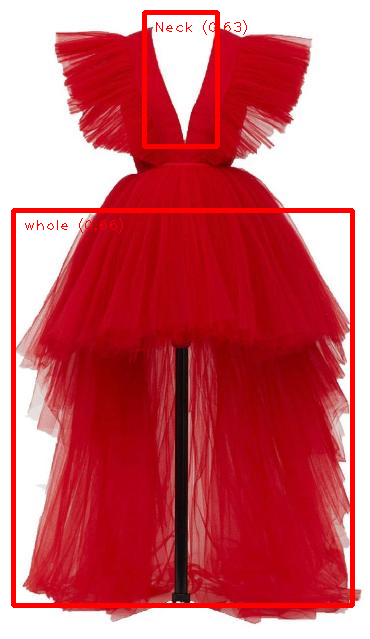

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/sleeveWidth8_01_jpeg.rf.a505274ff206e84267a2af565aa843c5.jpg


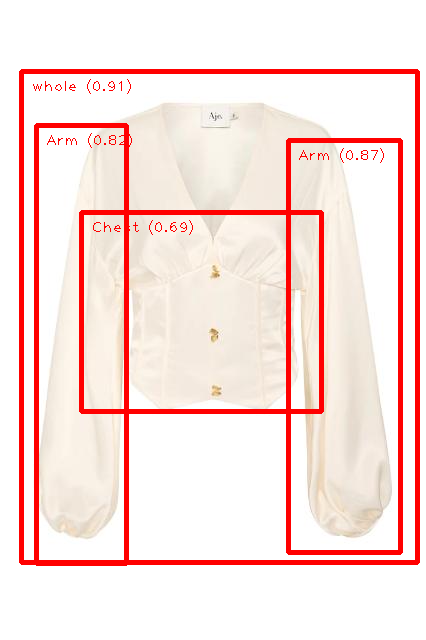

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress18_jpeg.rf.01fbe2bcb54a7e5b8da9a81e1c2cacce.jpg


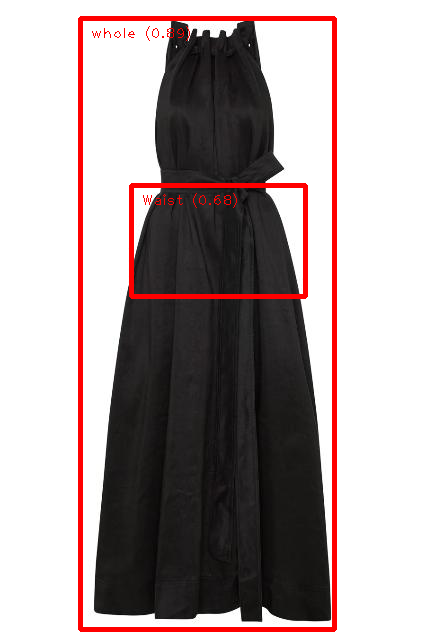

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants98_jpeg.rf.a3307d00e053851f669691c99f3449ae.jpg


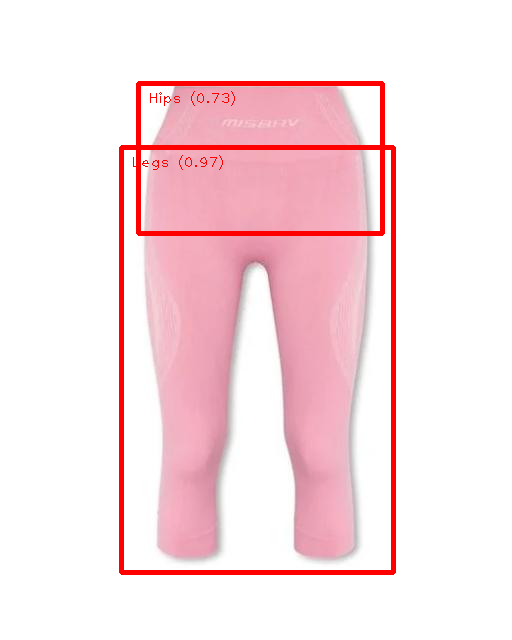

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pantslong66_jpeg.rf.1a7c1da5d11989998047e01b64da5db2.jpg


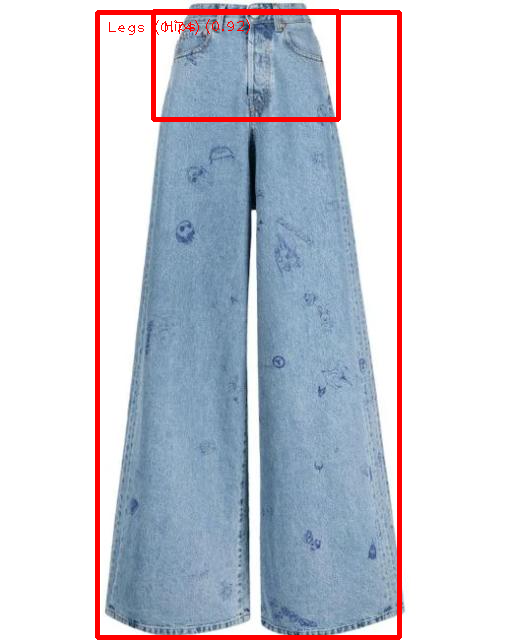

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/legsWidthSkirt6_02_jpeg.rf.0a74633cf4c7060ec32462b10924faec.jpg


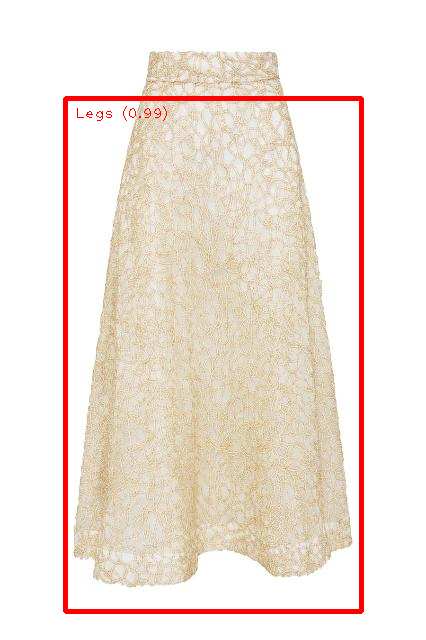

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shoulder2_01_jpeg.rf.dae559fbde620d746263ab71c59d9adb.jpg


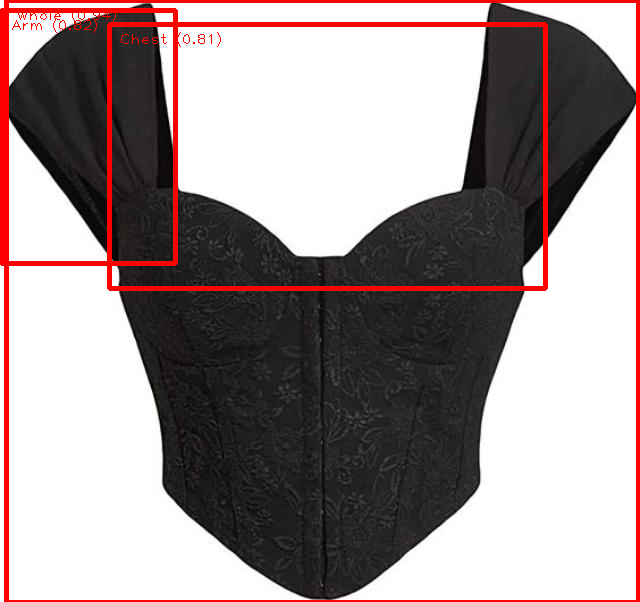

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants115_jpeg.rf.fdcb913763e7a15262a1e4f25308171c.jpg


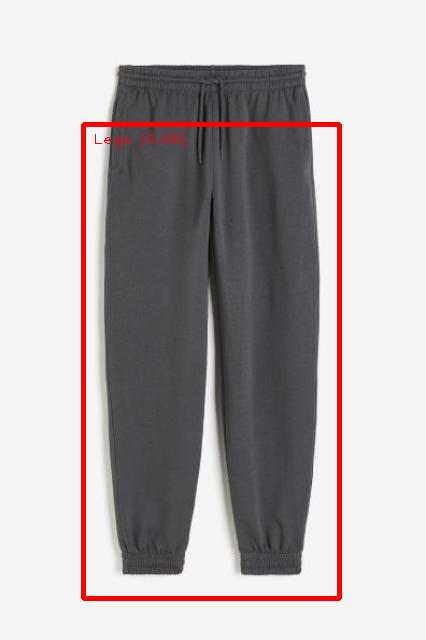

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops75_jpeg.rf.e18310b8162548b1eb1d749f005a6a94.jpg


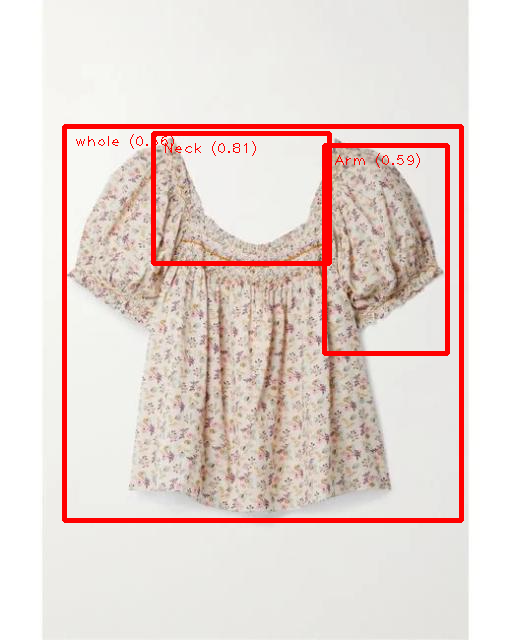

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/Neck6_07_png.rf.09def4c967c04d5e52d73f4f07620459.jpg


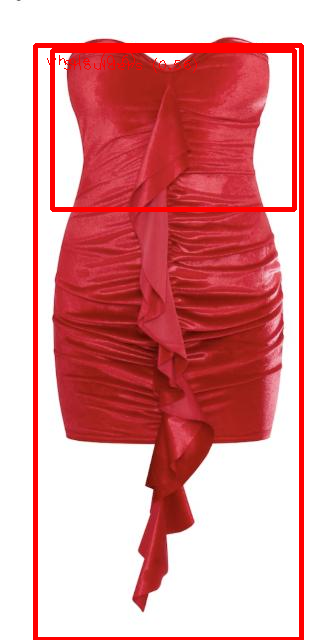

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jacket63_jpeg.rf.295c5c54655c37edfca7a3d9ad6c57c8.jpg


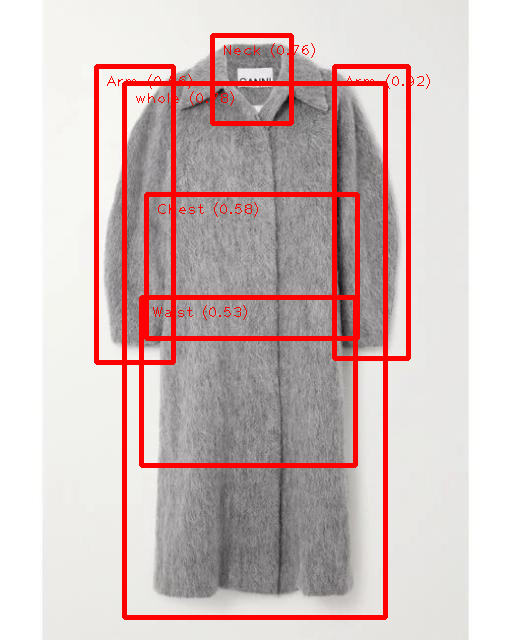

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt106_jpeg.rf.d2e48f4e4b39da4aa8e16e16517afc6d.jpg


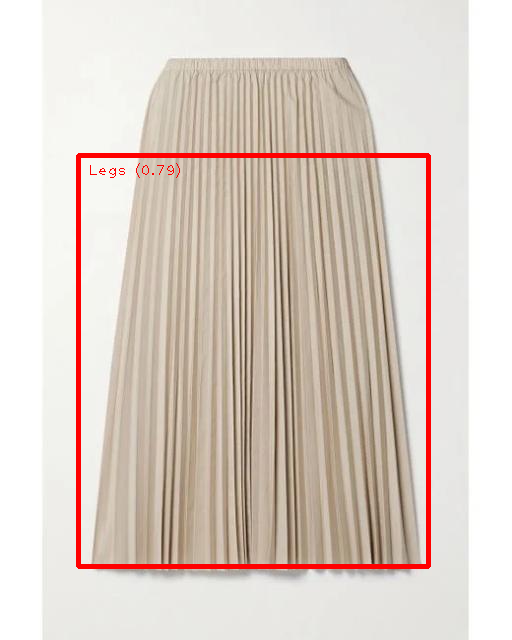

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/legsWidthSkirt6_05_jpeg.rf.ec648d3f7cecb8283f2d87c51c53eb80.jpg


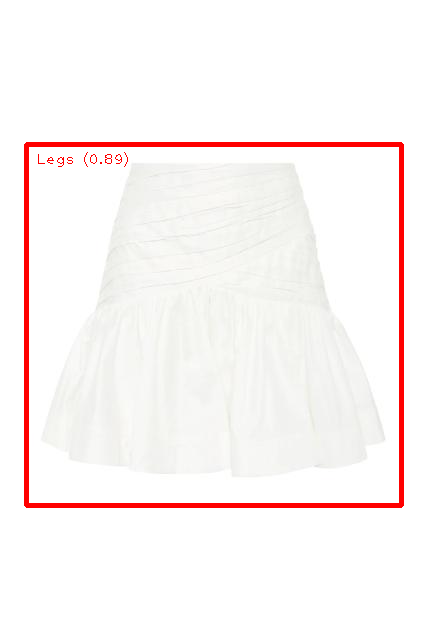

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress26_jpeg.rf.74a2eca619c469a12f71864503fbfcc9.jpg


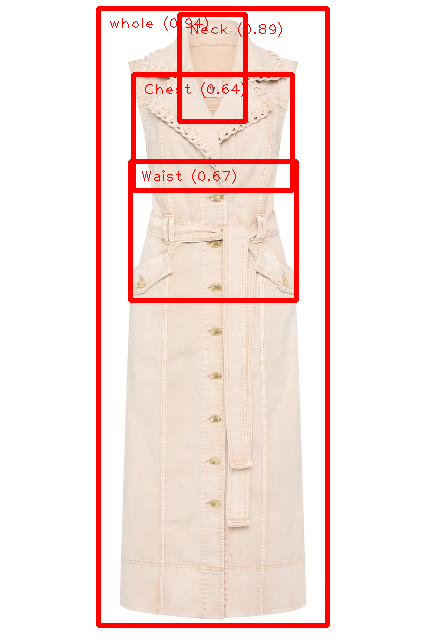

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants19_jpeg.rf.4aaf2b35597e5e1d60dbe1f706088a3f.jpg


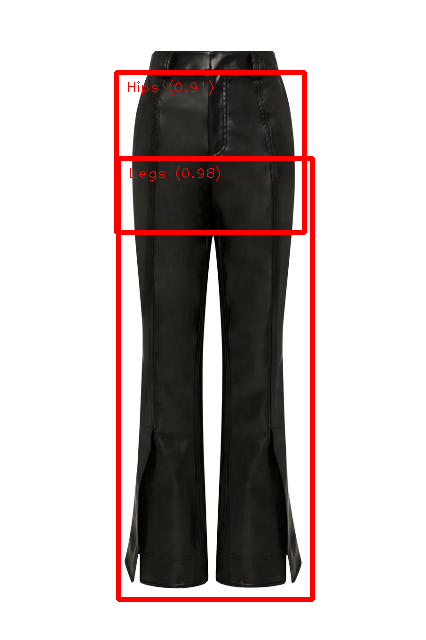

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops72_jpeg.rf.7eb9d6e7e237c1a6d6168dbe083a877d.jpg


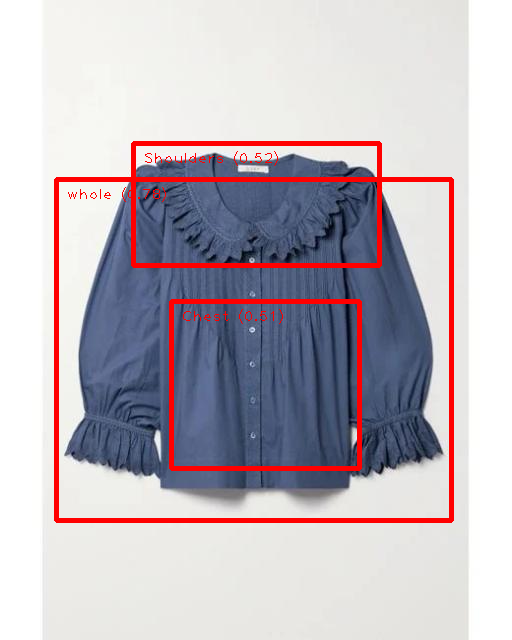

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress89_jpeg.rf.d68742cea4edfc13bcb82eaf5bb0b14c.jpg


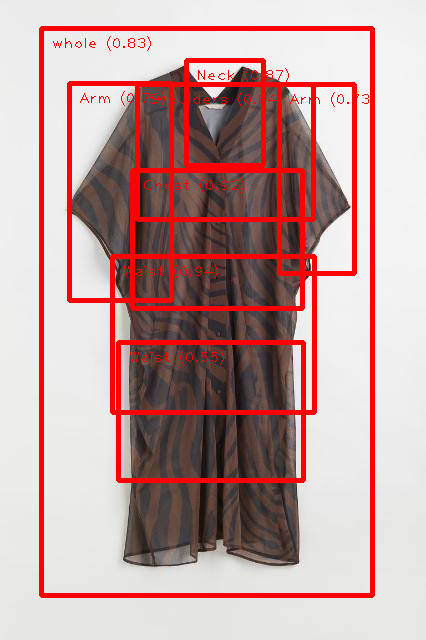

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt78_jpeg.rf.b644be0dc788ec7d7d8b24a50ad7f4d4.jpg


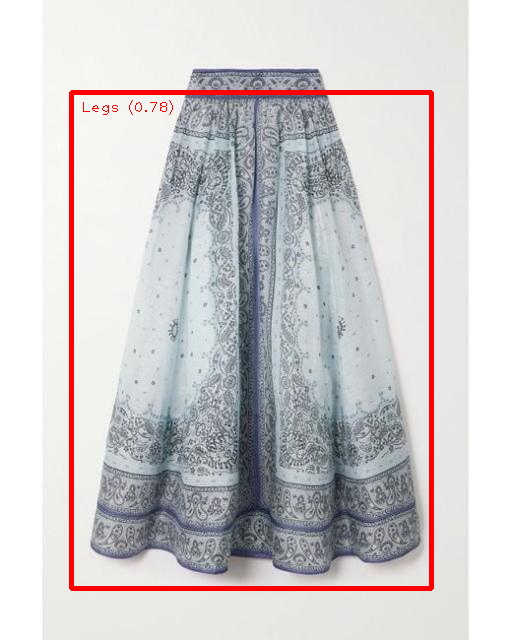

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress36_jpeg.rf.1610ee80ac633abe3d19e35a816633b2.jpg


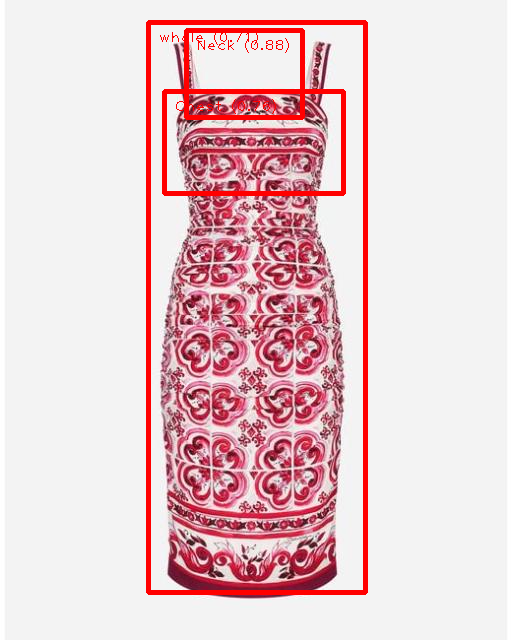

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts28_jpeg.rf.9b1e8efc0fa27a5900af076a1d34c90b.jpg


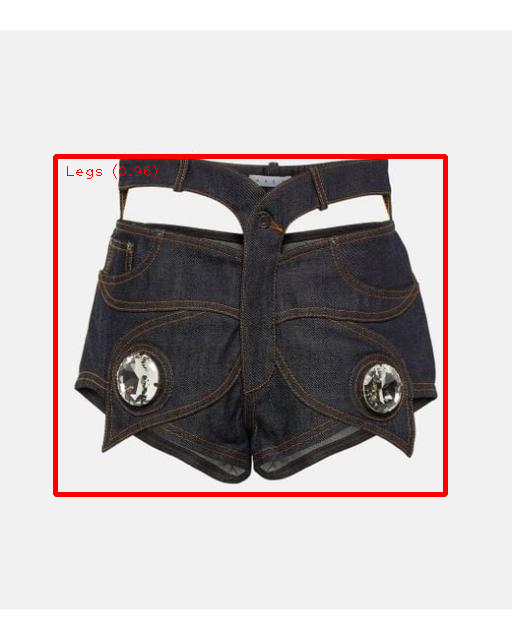

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/sleeve5_03_jpeg.rf.5ad69a9240da978ae3bb70422e51316a.jpg


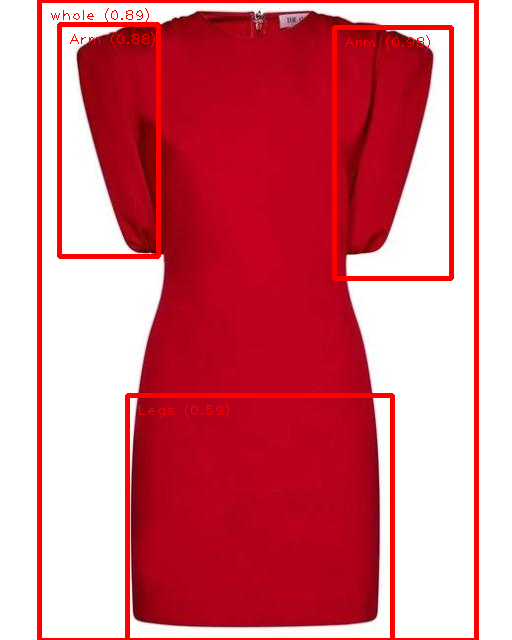

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts126_jpeg.rf.b30eaca2cacef974ef704603c4c5cccc.jpg


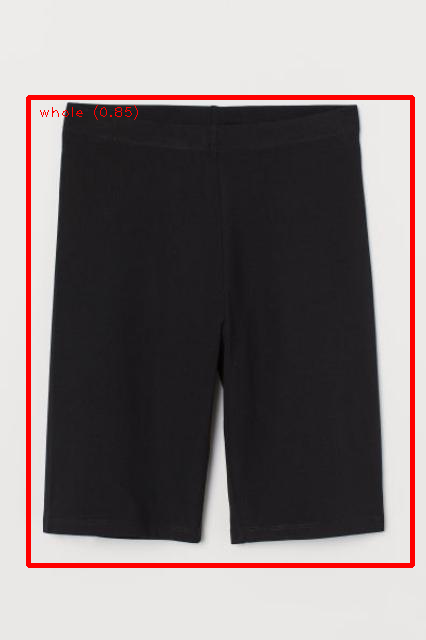

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/waistp1_06_jpeg.rf.99a0ca265a8b387279800228438dc722.jpg


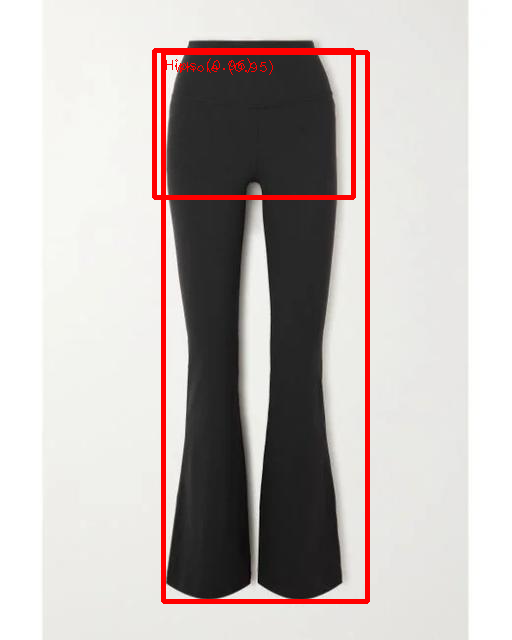

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress93_jpeg.rf.f6051848898ca68cf8c6e55c5897c901.jpg


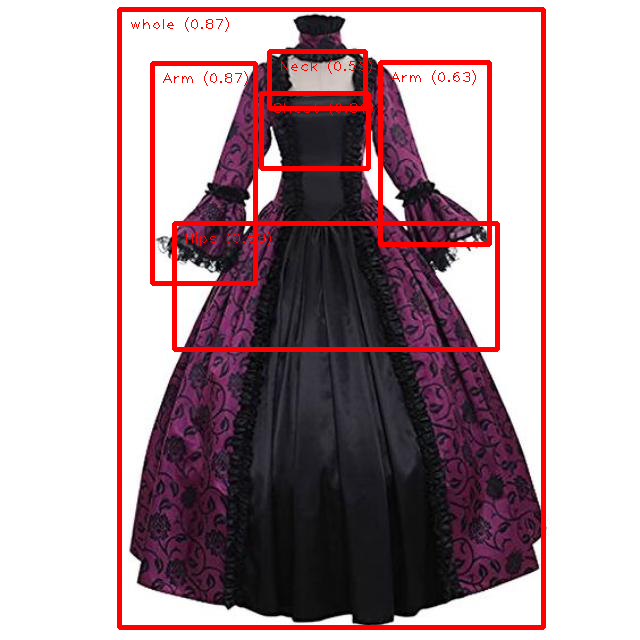

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts14_jpeg.rf.fe680dca17a6536161c773cb8c686495.jpg


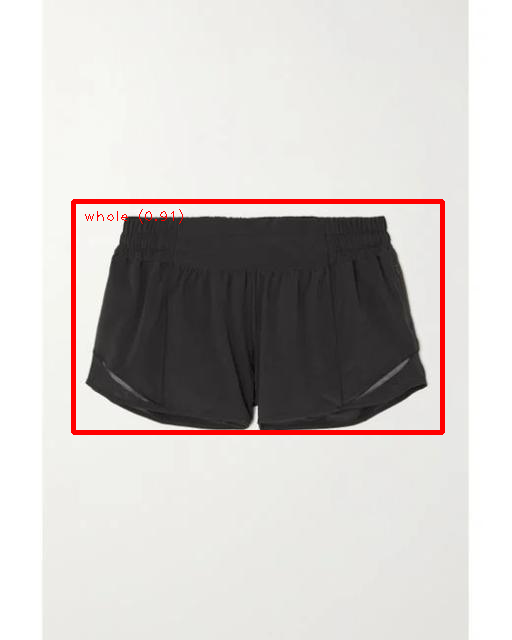

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/legsWidthSkirt2_03_jpeg.rf.fceff61dafba947eac00ef3fd338cfdf.jpg


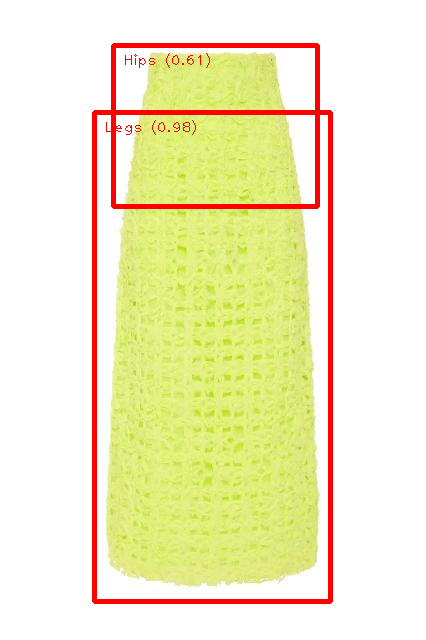

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops64_jpeg.rf.ff9a725a603ab16150ee60db049fa372.jpg


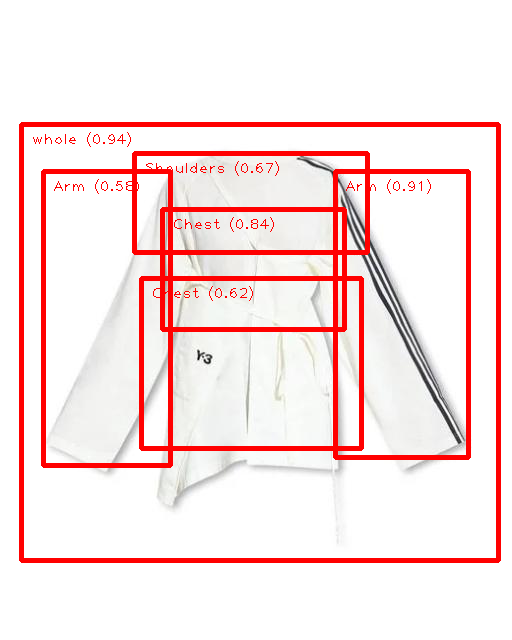

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress146_jpeg.rf.7733a303b4506953eac74b21327cb53b.jpg


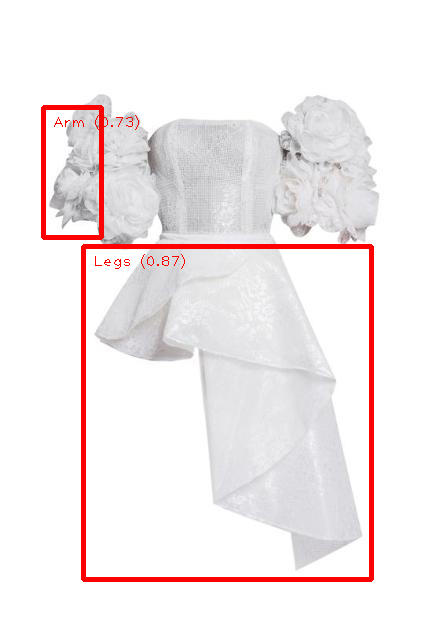

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jumpsuit11_jpeg.rf.177e2093a6211a29dd738a117673fb56.jpg


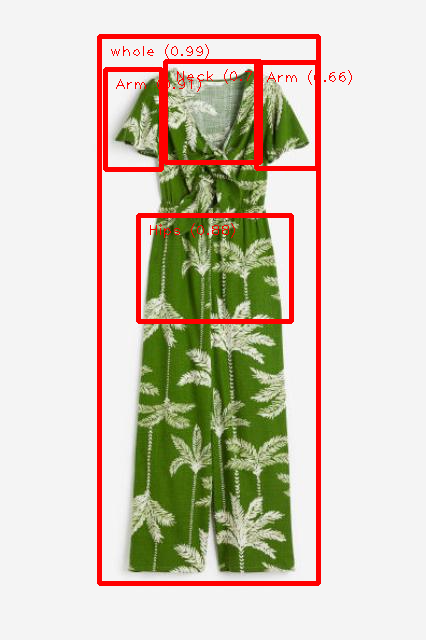

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts89_jpeg.rf.aace4ea8d91e680a5a6328bae4a1bc13.jpg


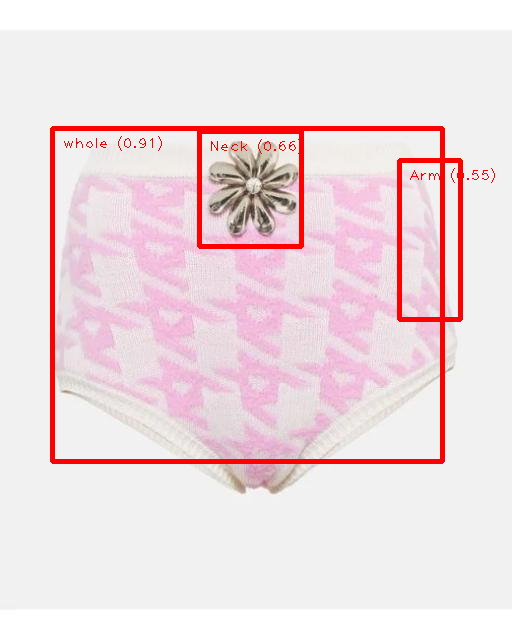

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts9_jpeg.rf.36c36bd410c6301c28c960c57dc8b8bd.jpg


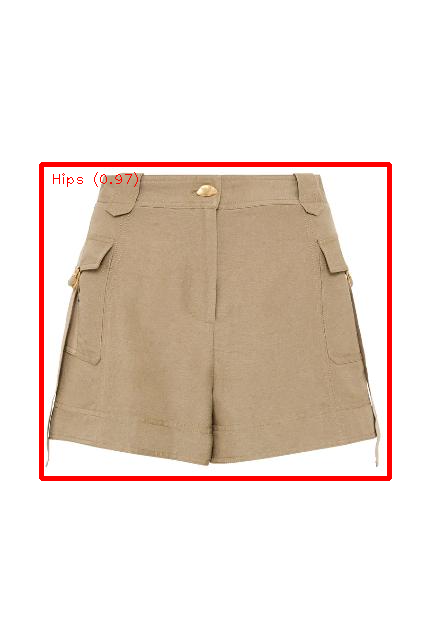

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/legsBreadth2_03_jpeg.rf.b72f52be83c489e5719b73a39709627a.jpg


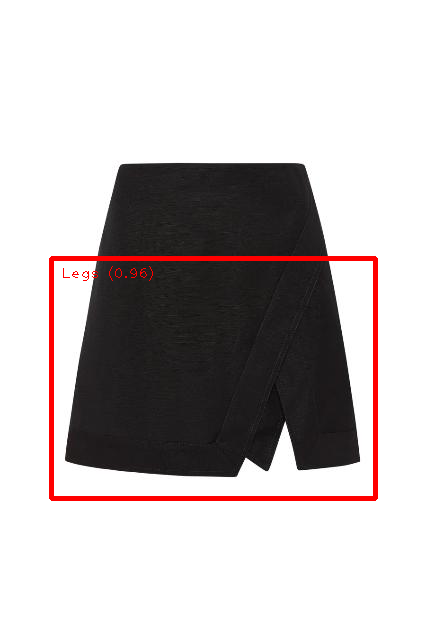

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/sleeve2_06_jpeg.rf.537028c06ef2c2b8684c8ecda42068b1.jpg


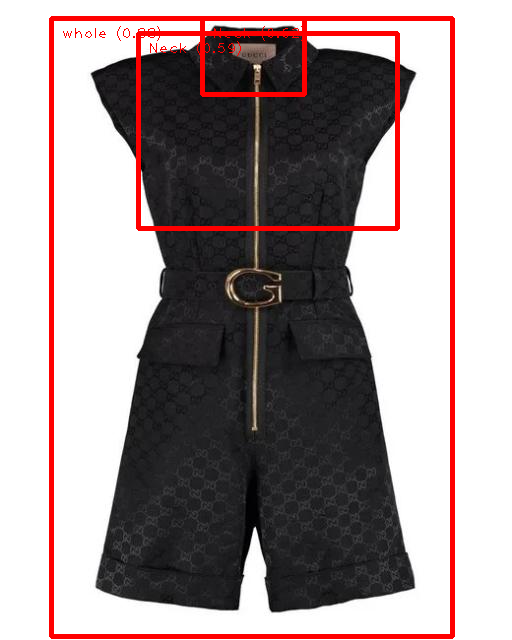

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/waistp4_02_jpeg.rf.e3e84602e5a6dc79c4eb4531a82b5675.jpg


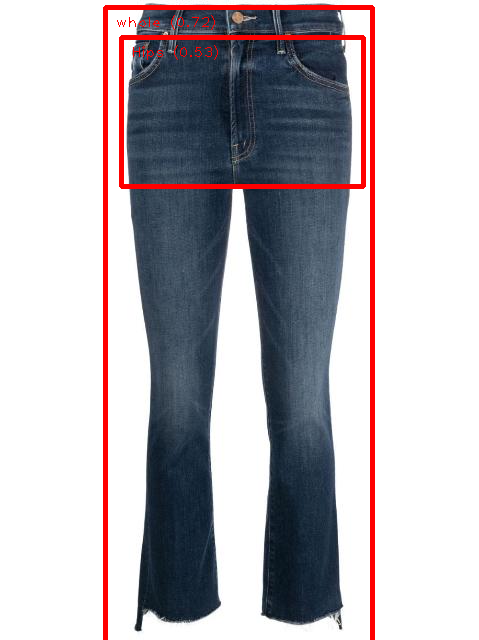

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jacket72_jpeg.rf.0e4527bd7c73af30c14510dced57a182.jpg


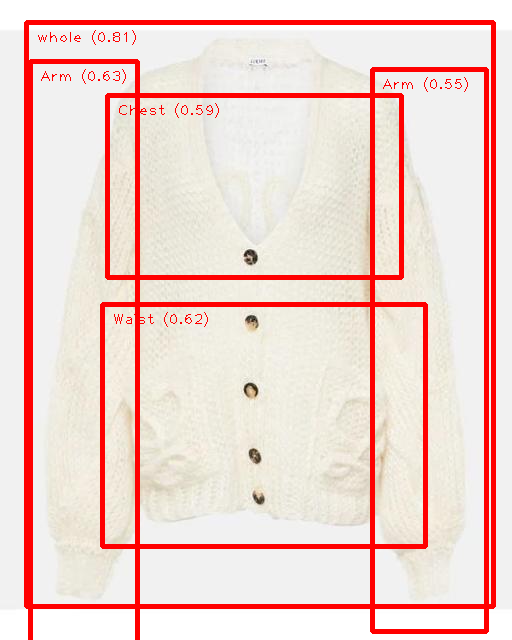

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants88_jpeg.rf.207eae5f7db6a105acaf22a816712ec8.jpg


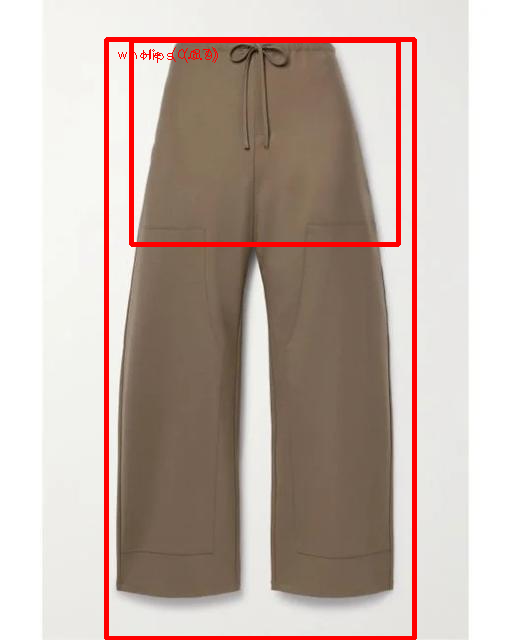

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt64_jpeg.rf.7e48875619b8efdbeb2b2775fb850759.jpg


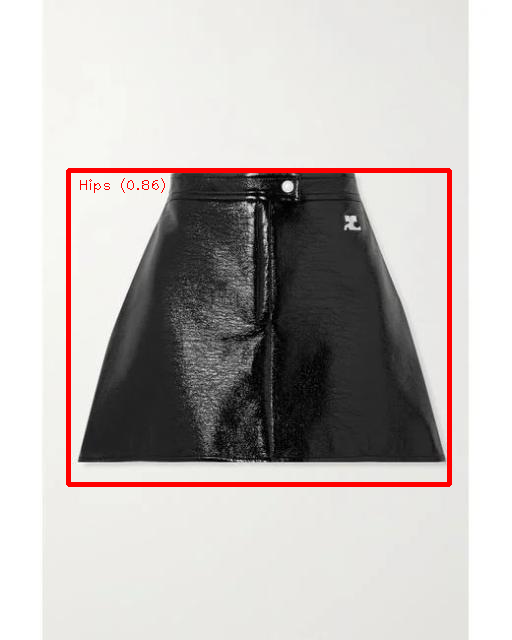

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jumpsuit72_jpeg.rf.20710288b5b15a2609ab1a9513c998af.jpg


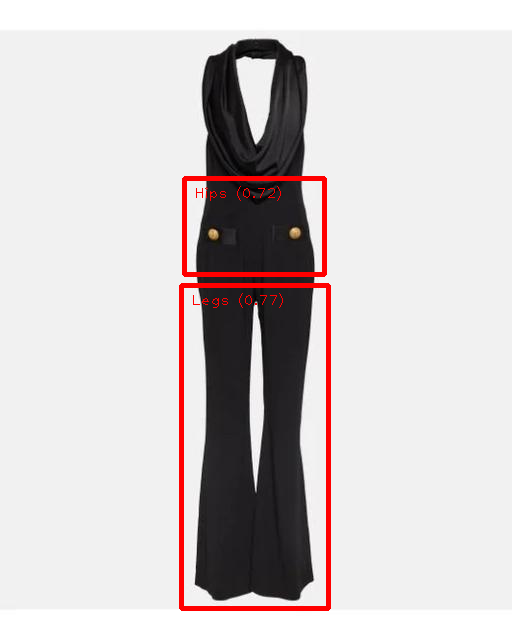

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants51_jpeg.rf.9fee81398edb77deb25fb8a60b05c184.jpg


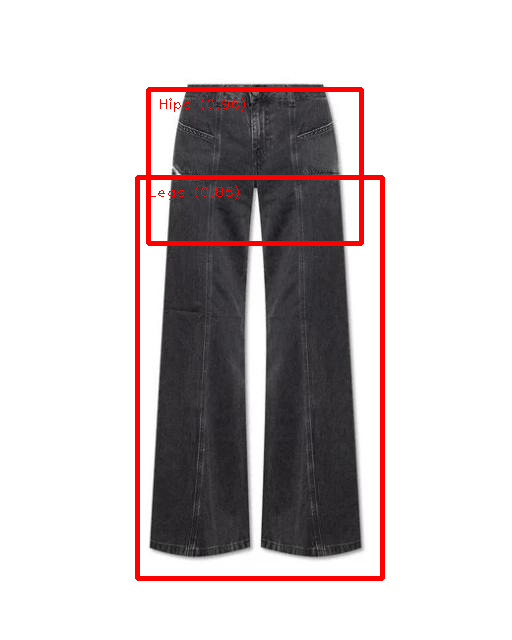

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jumpsuit28_jpeg.rf.0798e9339dd7847b1647e8771833dcfd.jpg


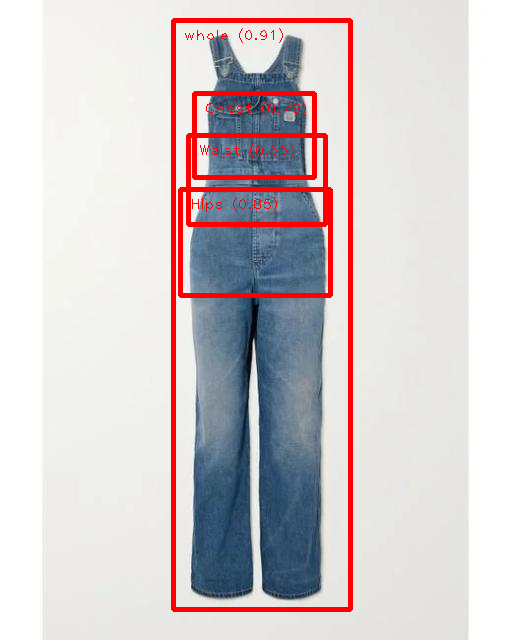

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jumpsuit13_jpeg.rf.e71b3c807f2d017a2a746f1a901e334e.jpg


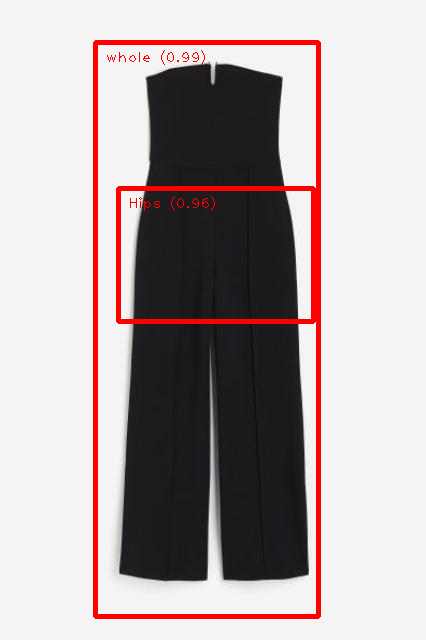

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt94_jpeg.rf.ff6c7fd43003664c6705f4babed4f555.jpg


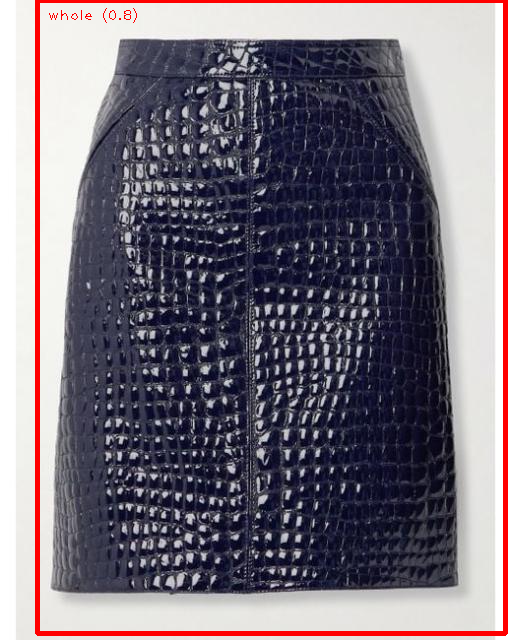

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt105_jpeg.rf.f9428687aea5c8a54b132a7b4b84aa3c.jpg


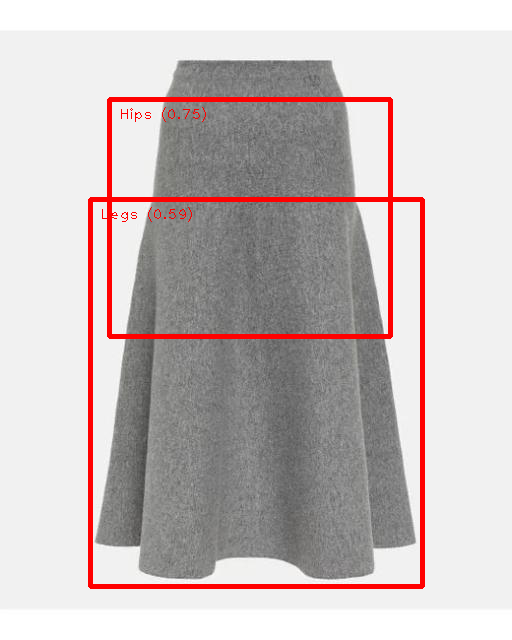

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jumpsuit3_jpeg.rf.7c8bc0f9fbee10988bb350bf2d3778ab.jpg


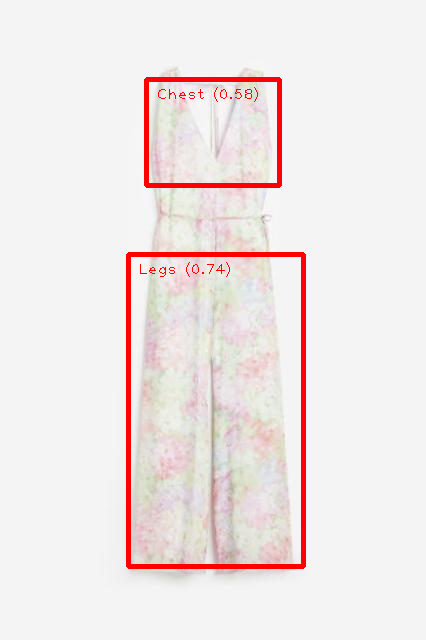

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants95_jpeg.rf.50354f121bdb0776096f530dd6ee9e44.jpg


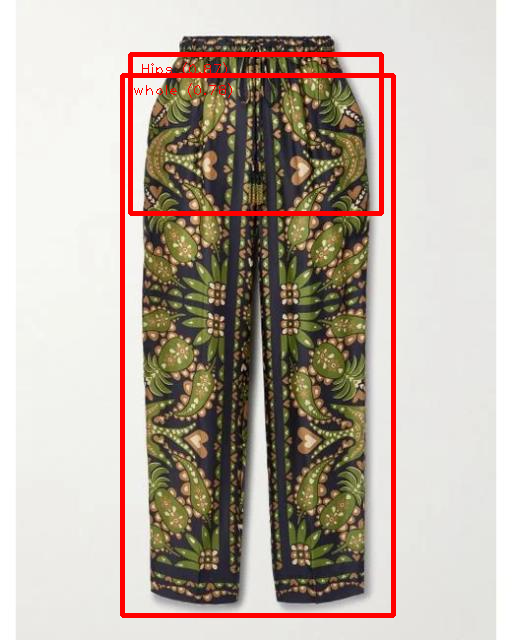

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/waist9_10_jpeg.rf.9395c2ed36752783fea38aaca2aa3fae.jpg


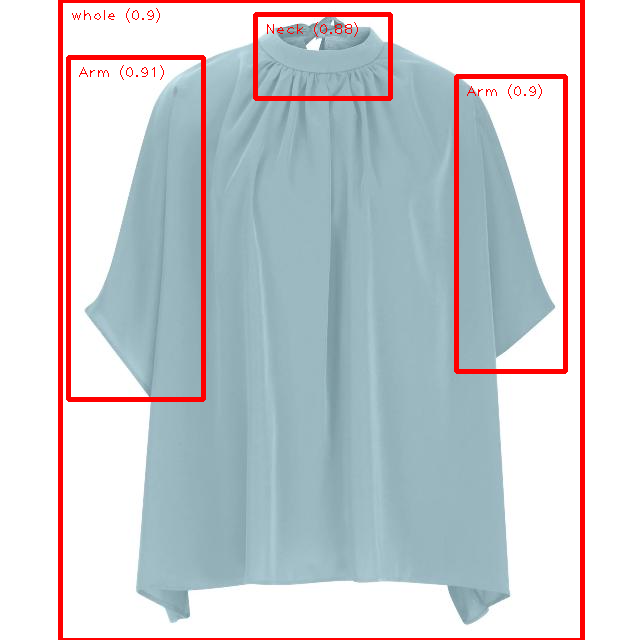

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jumpsuit69_jpeg.rf.7564aba2a40da59329f840d0f42b7fc8.jpg


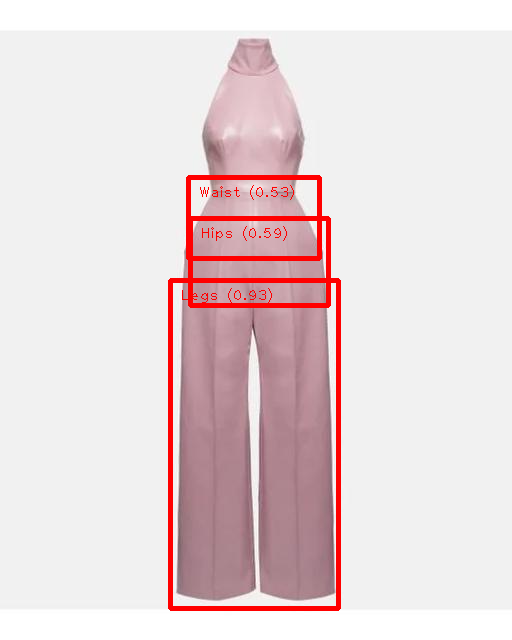

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants122_jpeg.rf.81cc15cf99f595506aee81c1b3ce0933.jpg


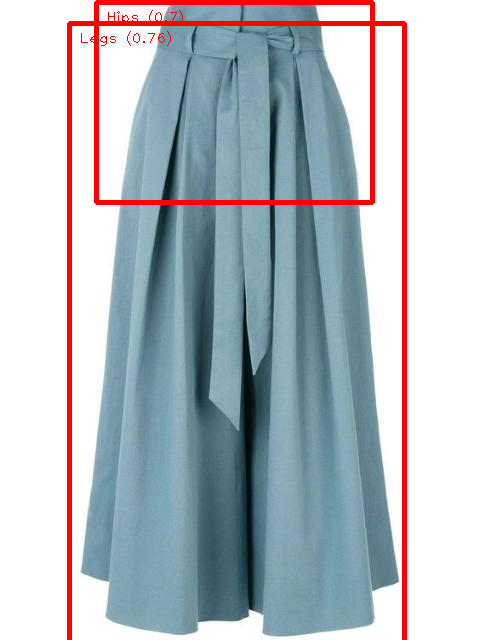

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jacket67_jpeg.rf.e13019696ee673caf360c47c2355a81b.jpg


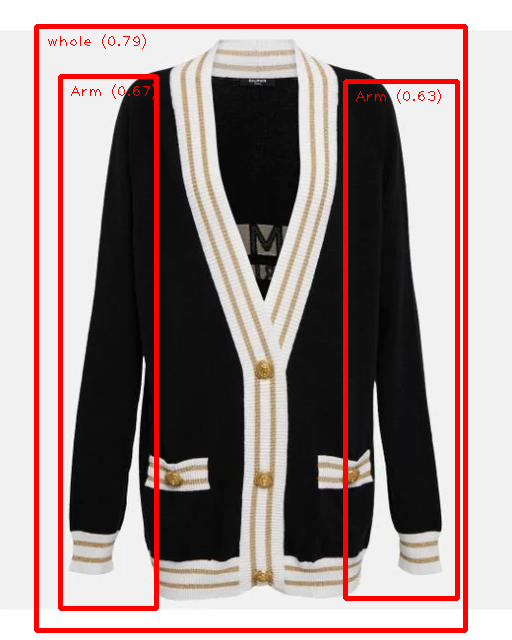

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt123_jpeg.rf.7342581d461af7e187862c931c686c11.jpg


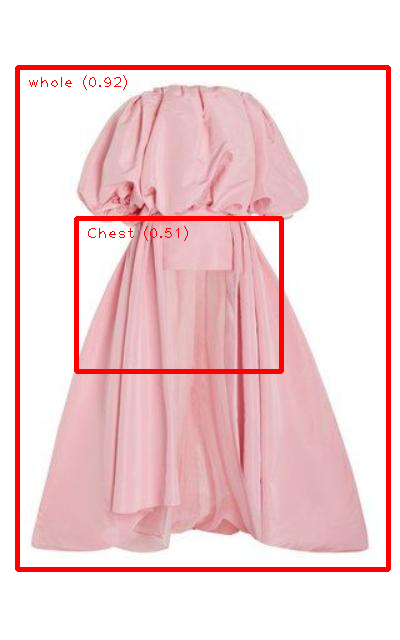

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/hips9_01_jpeg.rf.f1aee207c69dbd2632d884467c7628ee.jpg


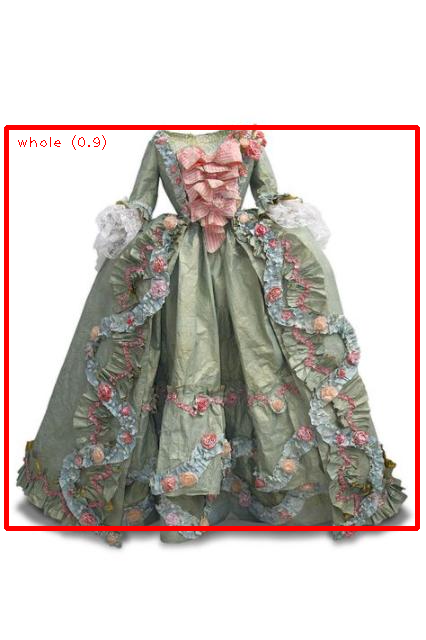

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts41_jpeg.rf.351befb072ff317169e339fce384d4b5.jpg


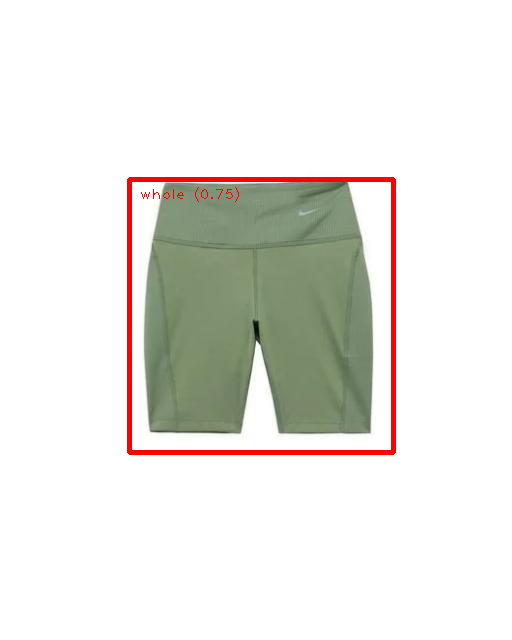

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jumpsuit73_jpeg.rf.bfb6778ca5f8c6a6f7ac8e66d1ed3128.jpg


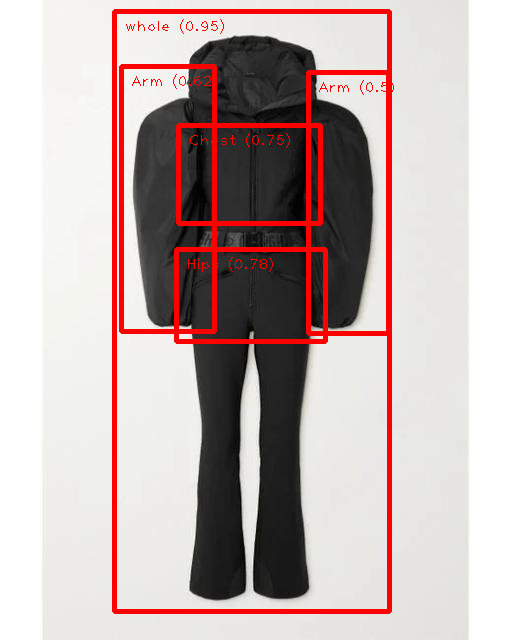

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress84_jpeg.rf.76593a09120c87225aee2668eb06ec0b.jpg


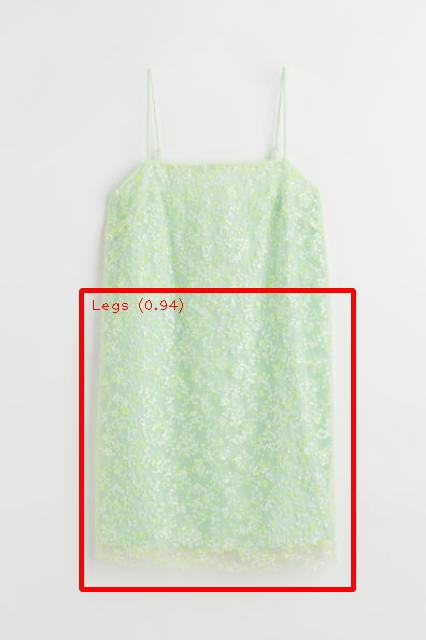

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts111_jpeg.rf.ddc58a750bc8a6d79dea34fb72d8ebba.jpg


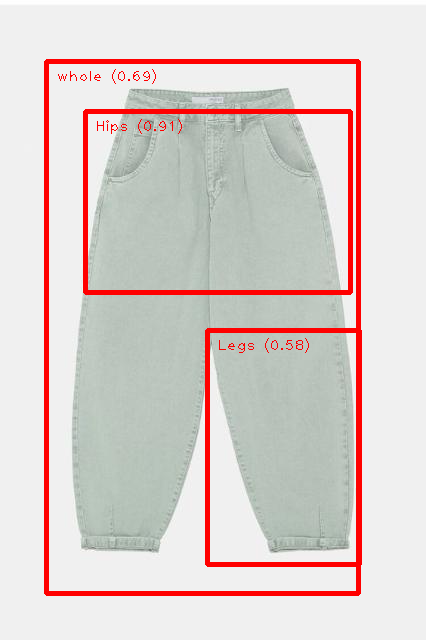

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops115_jpeg.rf.be135c3141fef8106a49776dc3996f15.jpg


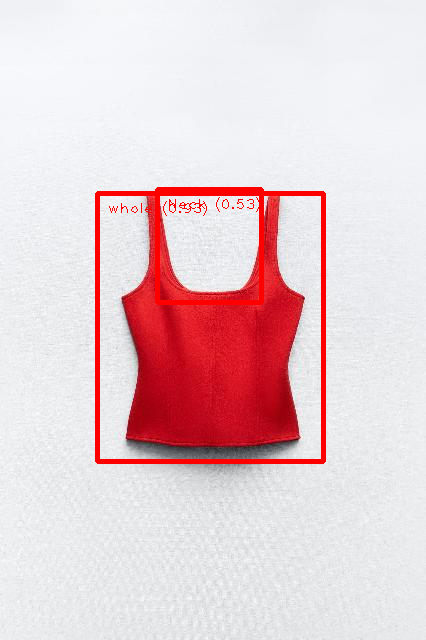

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jacket23_jpeg.rf.d7f11a316282871ae842152ef1fbe893.jpg


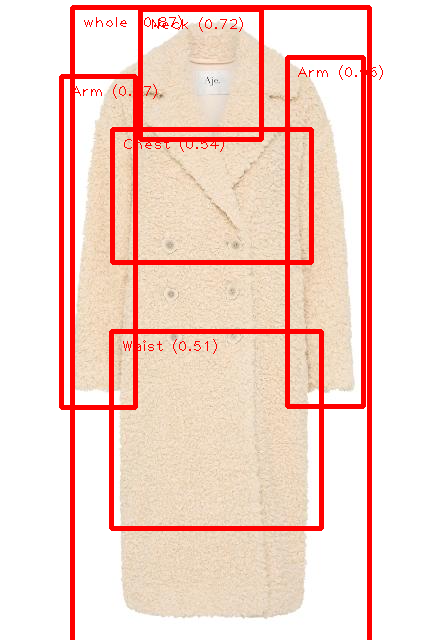

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress17_jpeg.rf.90ad152ede226b5a038227eaea69724b.jpg


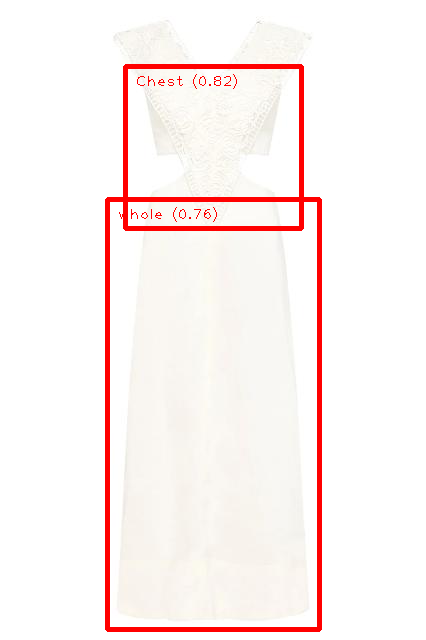

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt2_jpeg.rf.e0d9e3c146835786a94c09c672937dbe.jpg


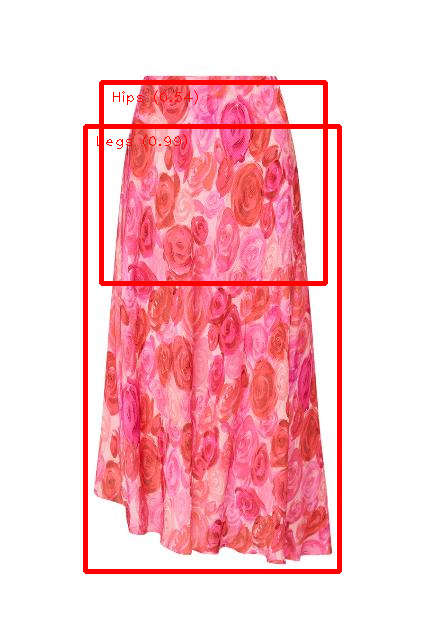

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops112_jpeg.rf.da28e84db8f1073bba1a6bca1cafdf93.jpg


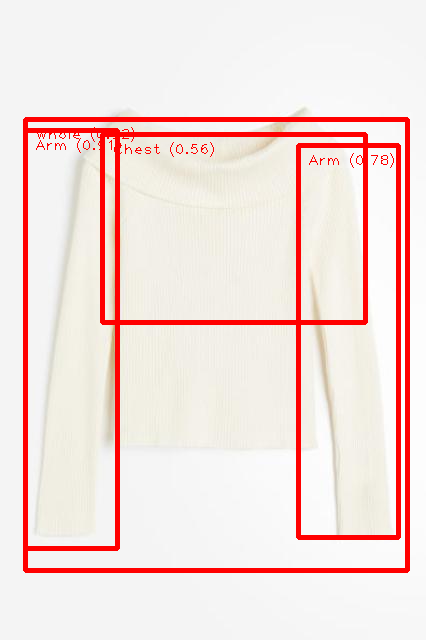

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt57_jpeg.rf.5f0a630868474b81d24dfc8743b8bc3a.jpg


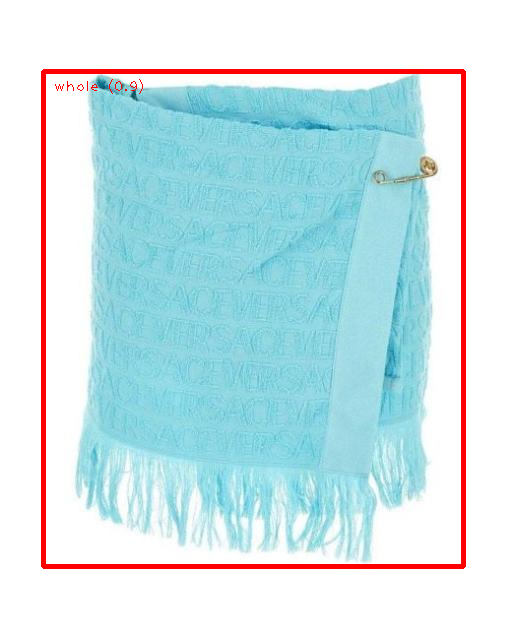

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants113_jpeg.rf.182092b5b072aee9ca60cf7cb121e639.jpg


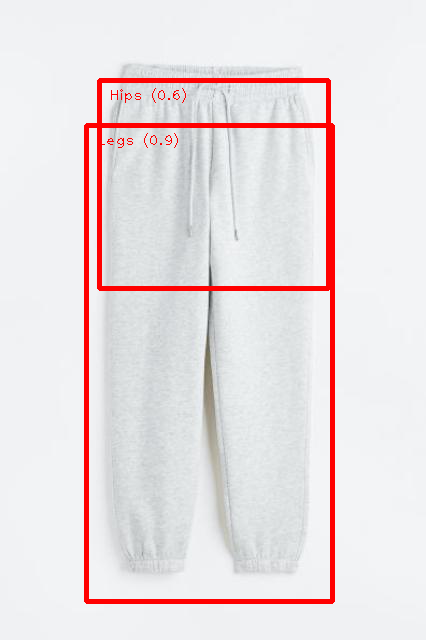

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt138_jpeg.rf.127668eb486c8fce0ef8e09db33428f8.jpg


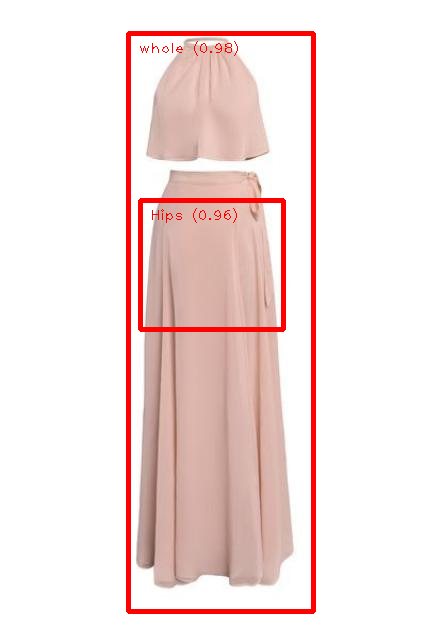

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jacket33_jpeg.rf.c67f13baec8d58b495594a1c4e1936d5.jpg


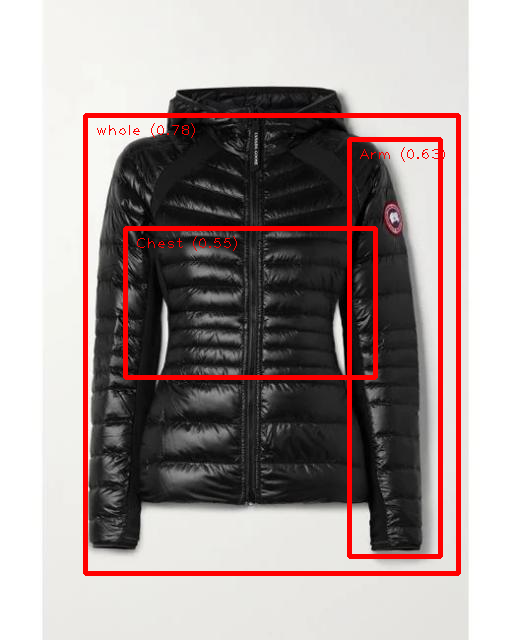

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt40_jpeg.rf.761011b6e1004711ff56eeecaf48d223.jpg


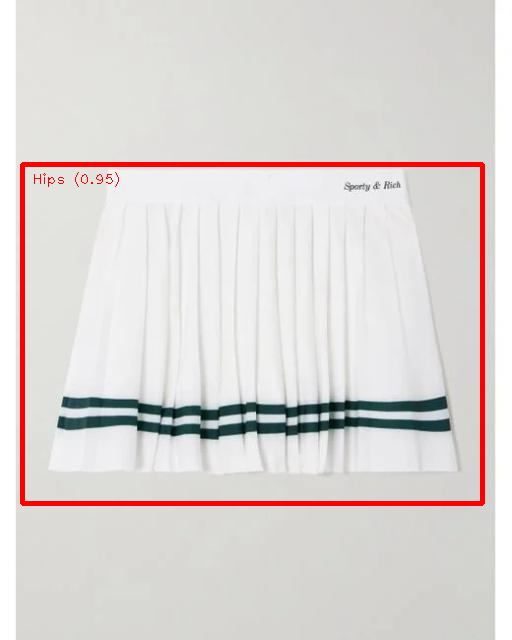

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops33_jpeg.rf.08242f8cc39504a1395b61b8dfd6960d.jpg


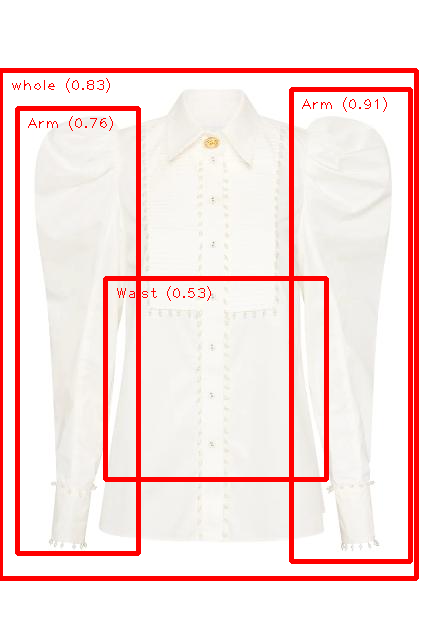

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt58_jpeg.rf.3f85a1cb21db3fc12f0bba6b93c7a1de.jpg


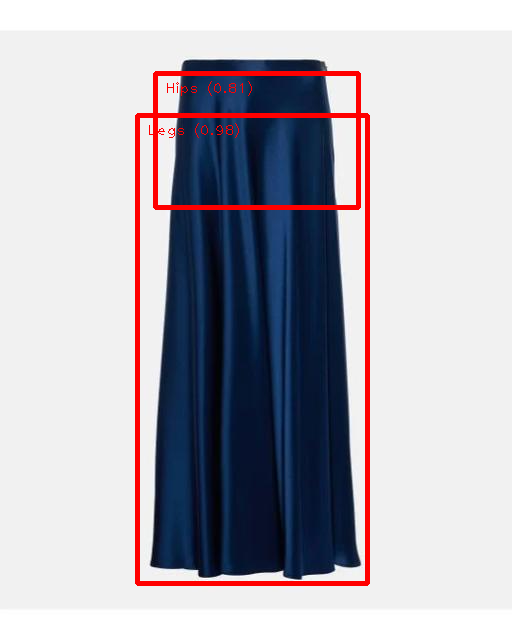

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts108_jpeg.rf.e29b3fb264749f452ca5b1c39ee8ebbd.jpg


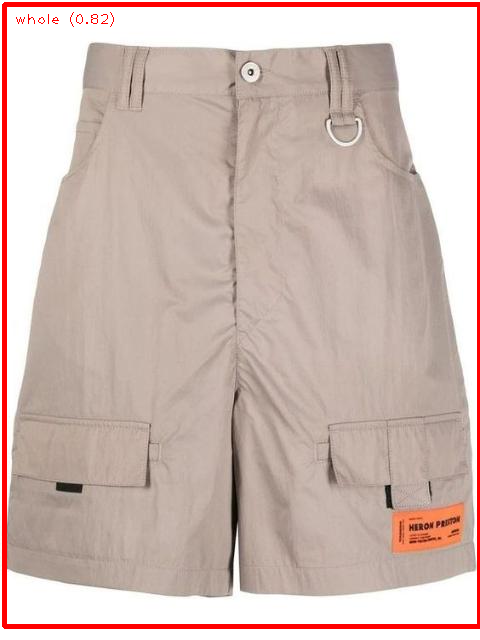

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants34_jpeg.rf.29eda5fdb9bbec3aaaea2518b99a31c1.jpg


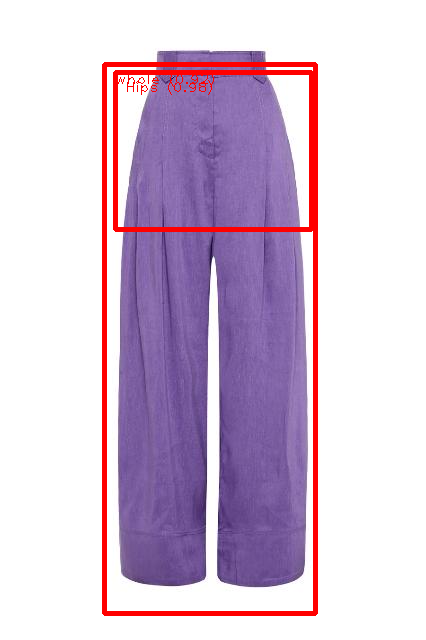

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants49_jpeg.rf.bc0a854838ed2e6e4b3c3c1e06a1aafd.jpg


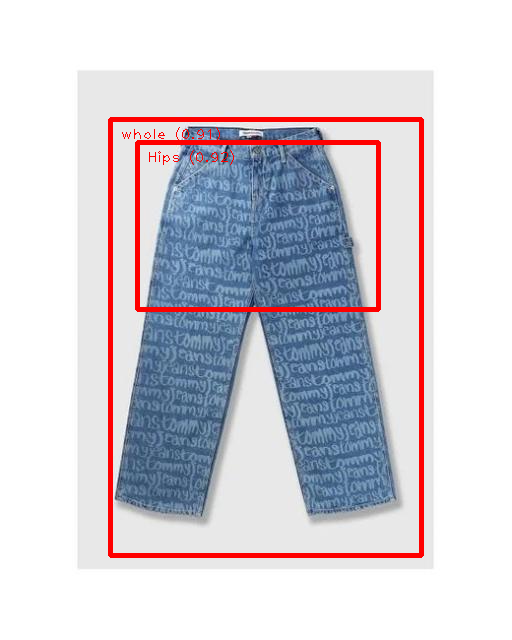

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops41_jpeg.rf.54b59c3f49e084cb171bdb46b3471542.jpg


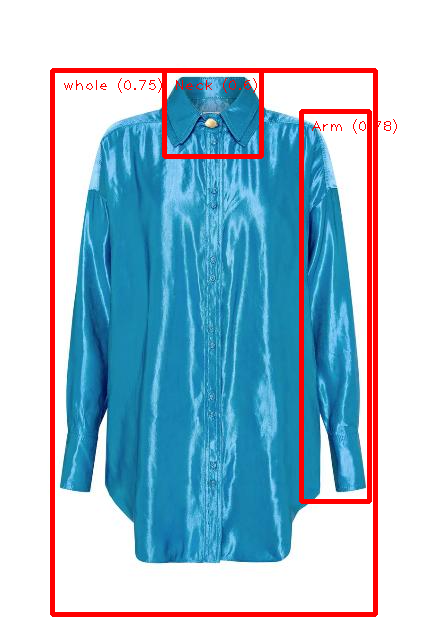

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress124_jpeg.rf.5c3d1acf043073206525fc48ea56cf80.jpg


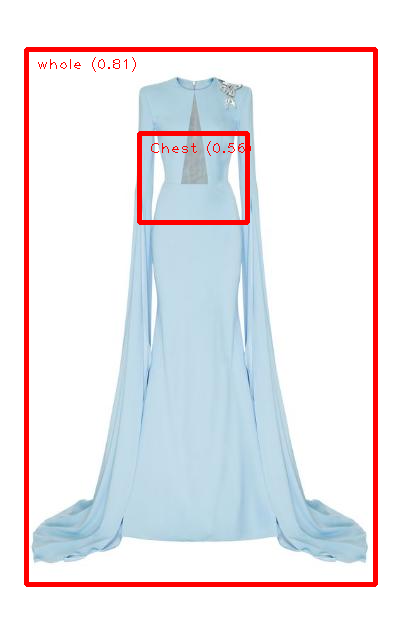

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt37_jpeg.rf.7bc948b6cc9ffc6c614c32eb4a0197e1.jpg


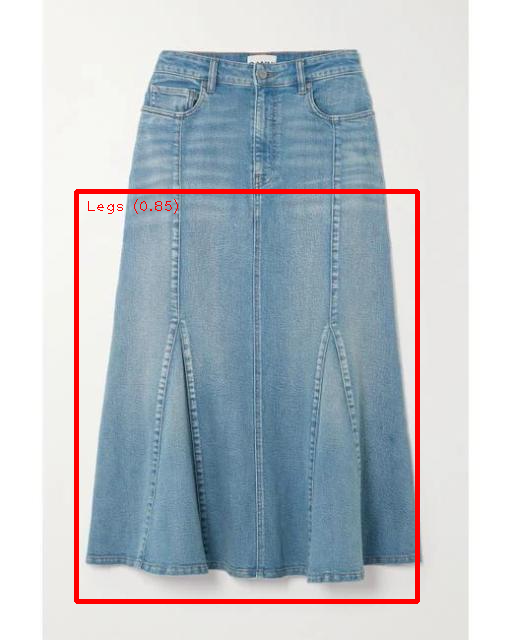

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress115_jpeg.rf.6836079ed8f5dff426683059ca8beceb.jpg


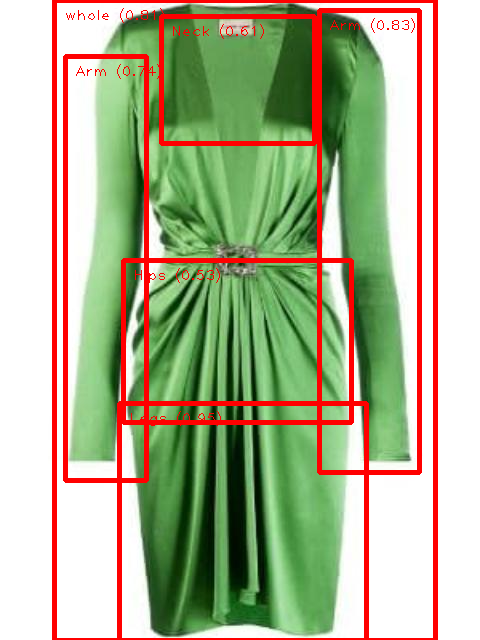

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops97_jpeg.rf.5c0a68bc5db60e1ee33da86c55a2ce53.jpg


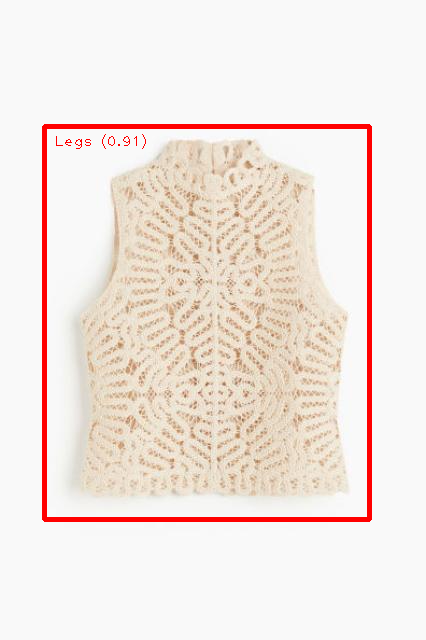

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/legsBreadth2_01_jpeg.rf.9b0536277bab3faec6af1828e6896c4e.jpg


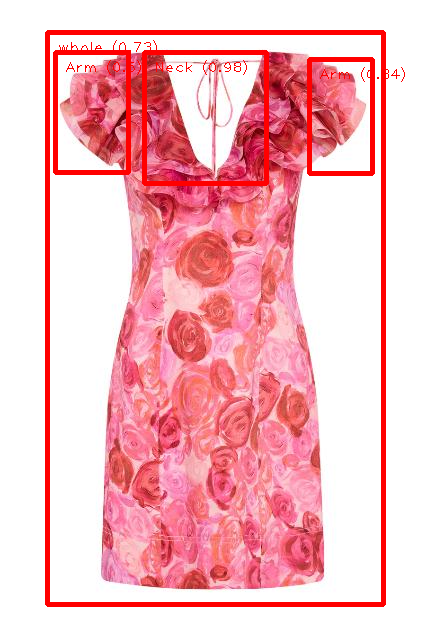

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress127_jpeg.rf.b0442e4ba5c8857094b9f47701cf8958.jpg


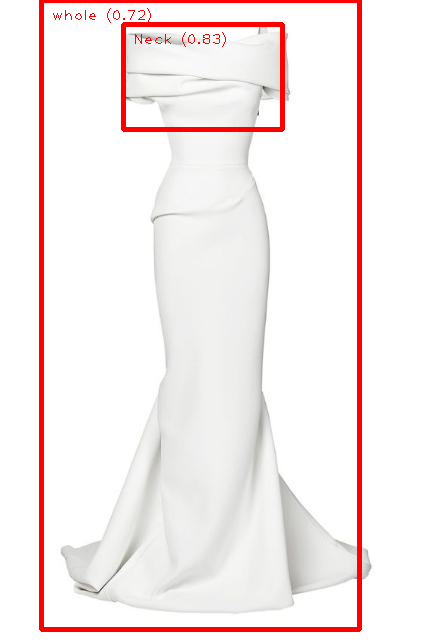

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt54_jpeg.rf.28ce171472688f097fcbb2d52330d9ad.jpg


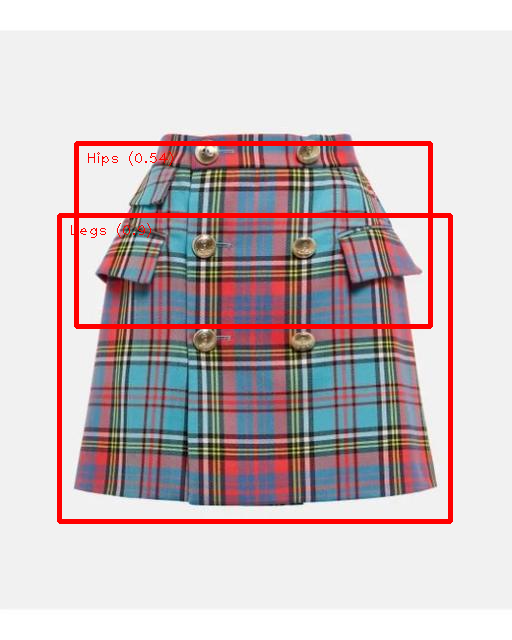

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress24_jpeg.rf.22f30018f8c9757d5bf2f7d93109c89c.jpg


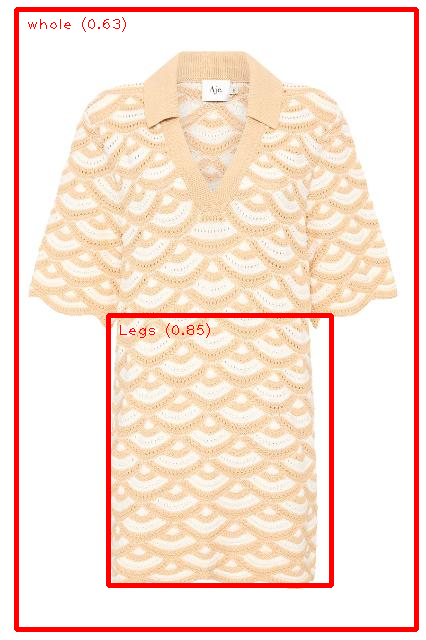

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/Neck3_03_png.rf.6be0417521707311911a3dad7c668333.jpg


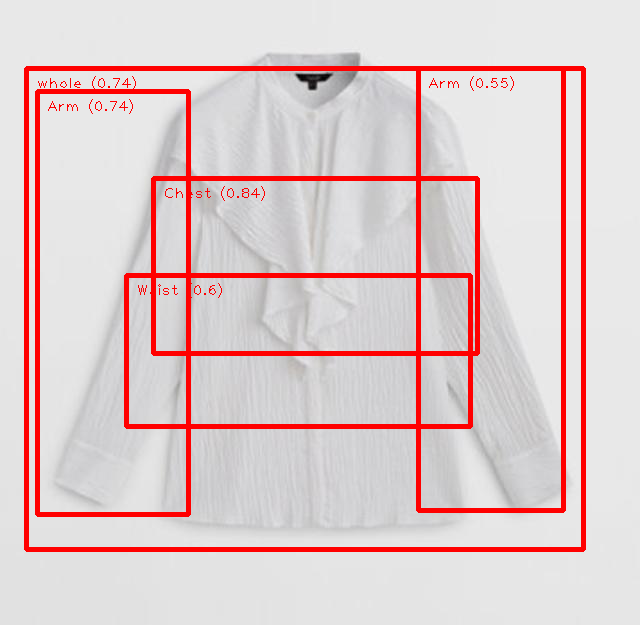

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/waistp4_06_jpeg.rf.bd524d77d35986814738d01f2665a167.jpg


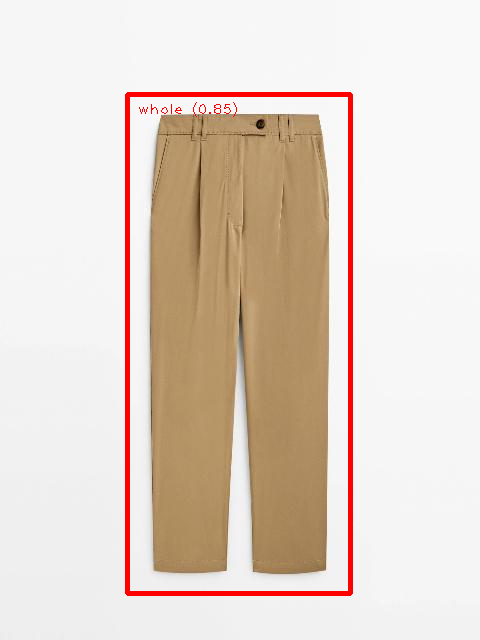

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/legsWidthSkirt2_04_jpeg.rf.ae58134b6286ad05b624c087f98c5e44.jpg


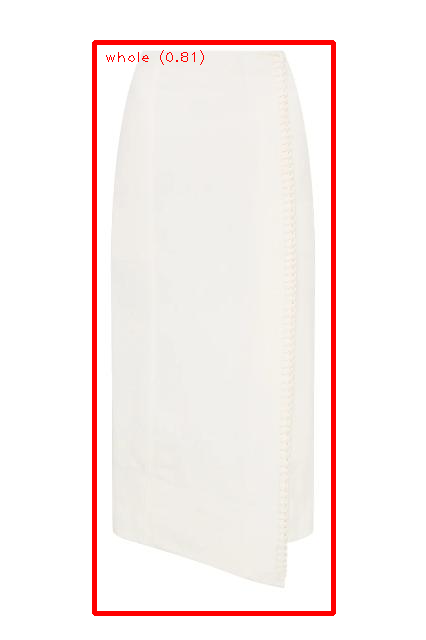

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants125_jpeg.rf.4c38d97e195f12bd30971953af5fce1b.jpg


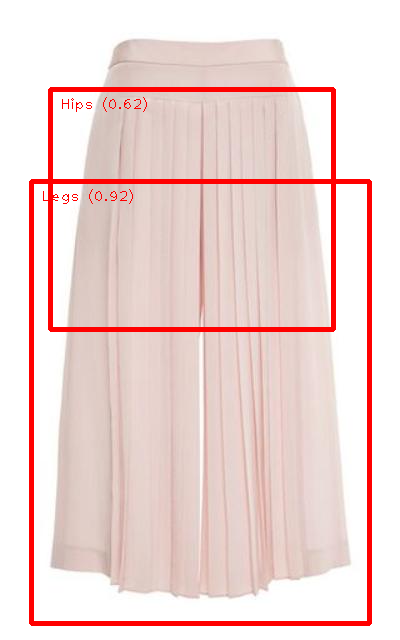

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops32_jpeg.rf.ee1f092bab10c97092362f758b33341b.jpg


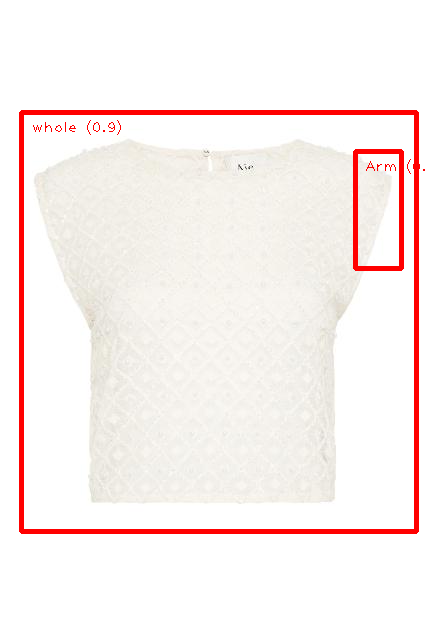

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops101_jpeg.rf.70009e8991fbaaaa9d17400f14862d1a.jpg


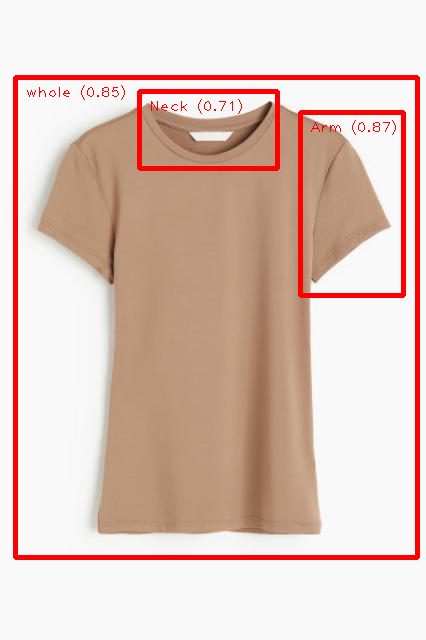

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts113_jpeg.rf.decb3acdbbbd17009e1664be6d903567.jpg


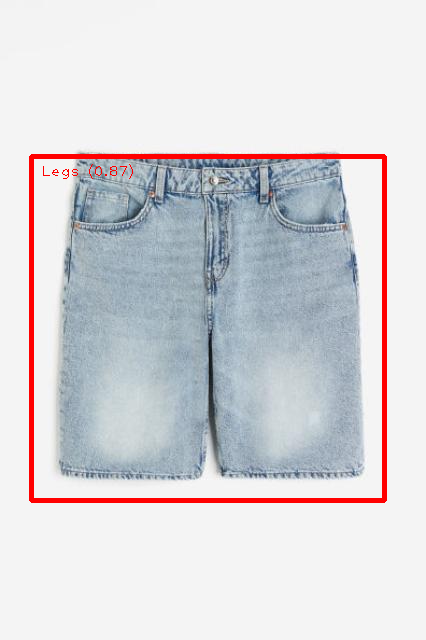

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jumpsuit90_jpeg.rf.2b39741d85cb6874647a197b0e248633.jpg


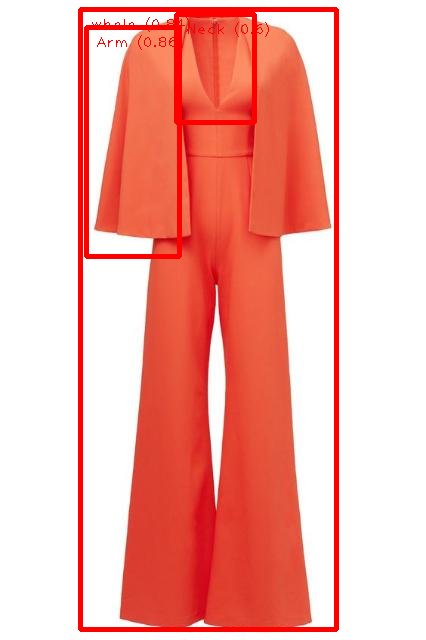

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/Neck7_01_png.rf.8276f25d16a0367f32ce85f9c18d05df.jpg


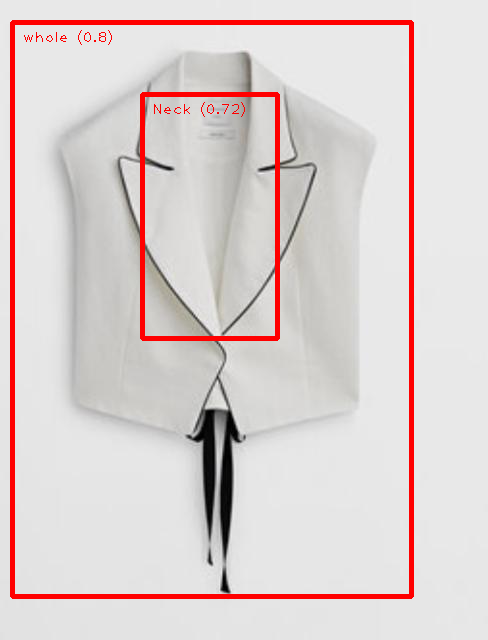

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops31_jpeg.rf.5a57c9db64a41b73dd337bce35607160.jpg


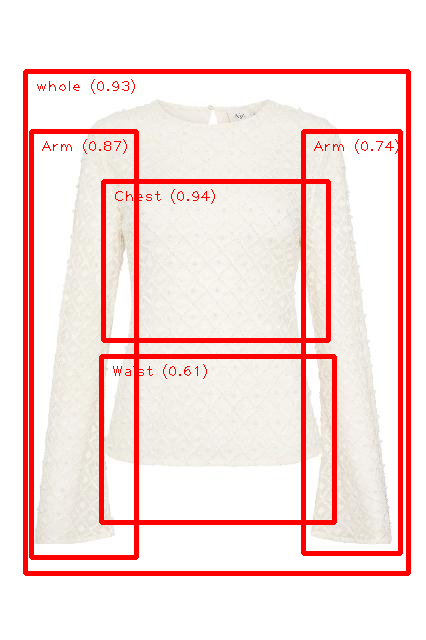

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt5_jpeg.rf.dc1fa96bc07ed3c53c5bd1e1994de368.jpg


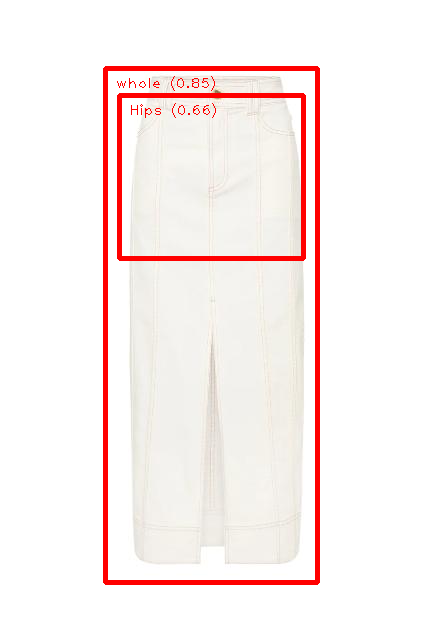

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops121_jpeg.rf.be0e879bb212423bf194e60dab701762.jpg


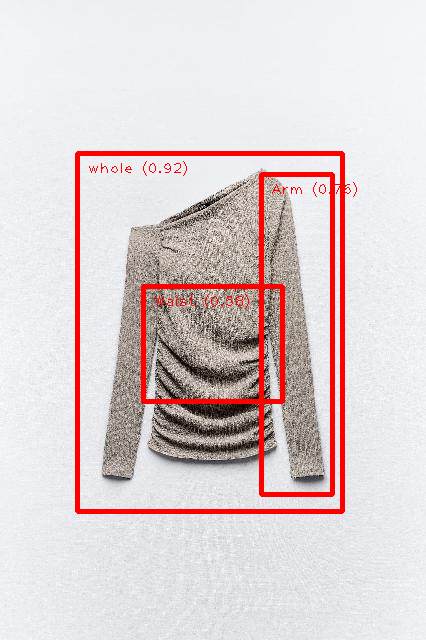

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt69_jpeg.rf.2847558097c60f8b1f80ebe1927c25e1.jpg


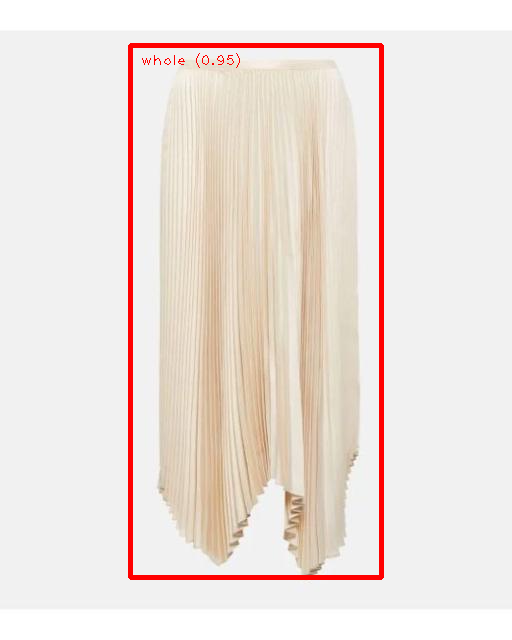

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jacket32_jpeg.rf.df5b87df6520a28635c92ded294cddd6.jpg


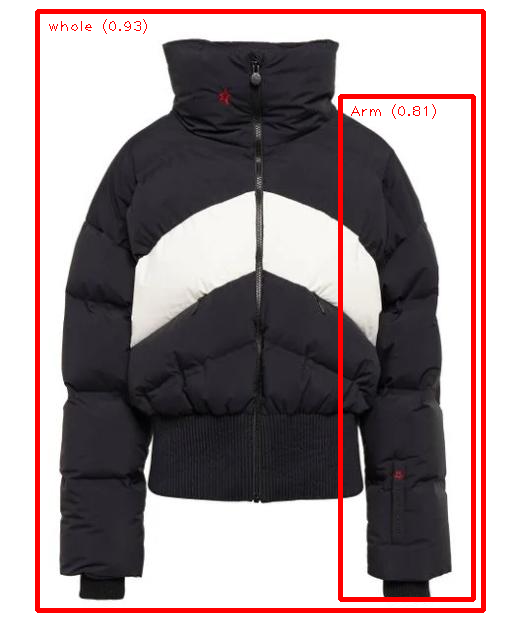

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts133_jpeg.rf.e3b47422f3b292efe1ddf4cfa82865fa.jpg


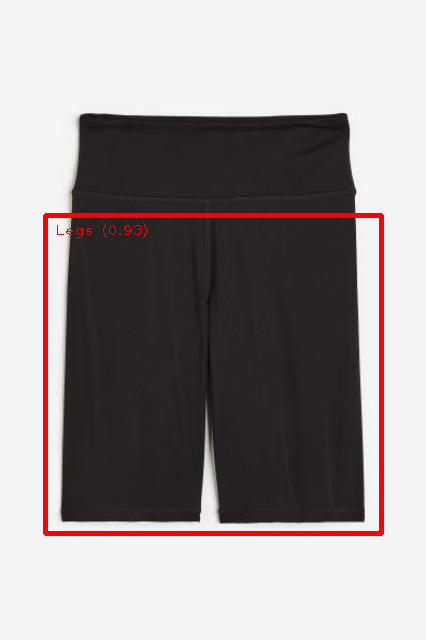

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts130_jpeg.rf.5296b2a51402b15df5c21307395b4a3f.jpg


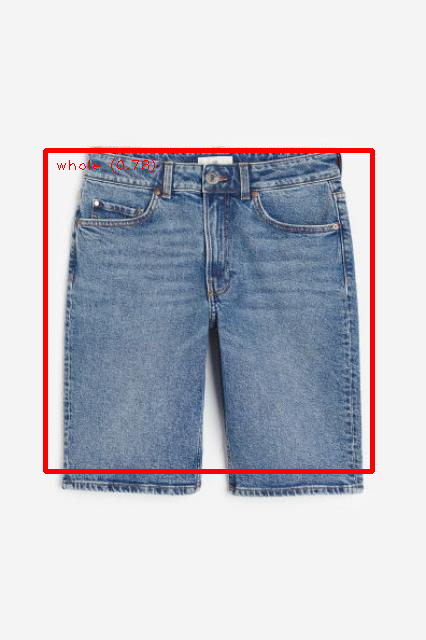

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress113_jpeg.rf.b66c9b405e119f911d188475594ab0bb.jpg


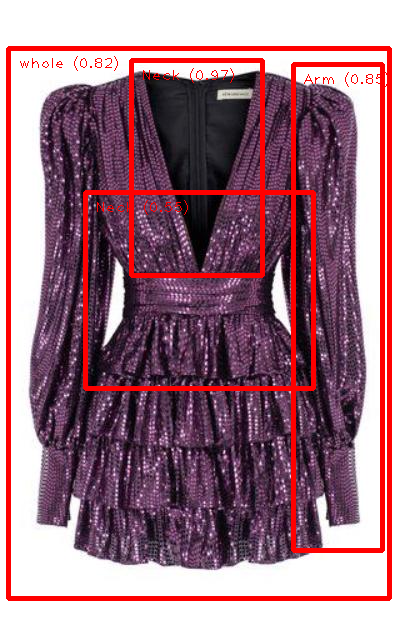

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/dress48_jpeg.rf.eb0608b65a1041bdd199b8ea2c7736a2.jpg


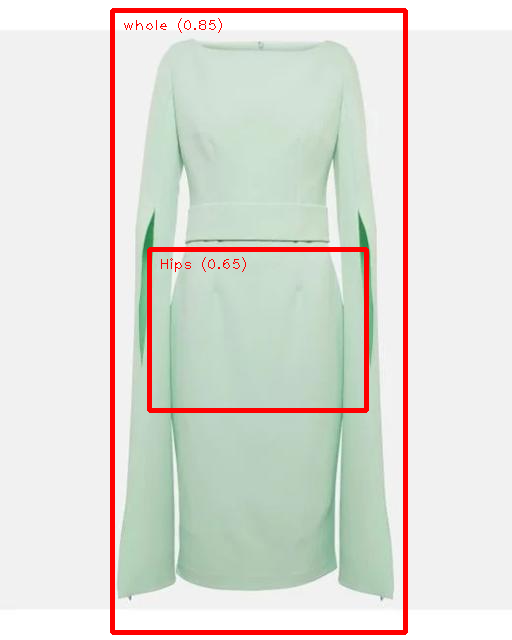

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops83_jpeg.rf.cbecba1d51cc52c0582b87aeffc4ac48.jpg


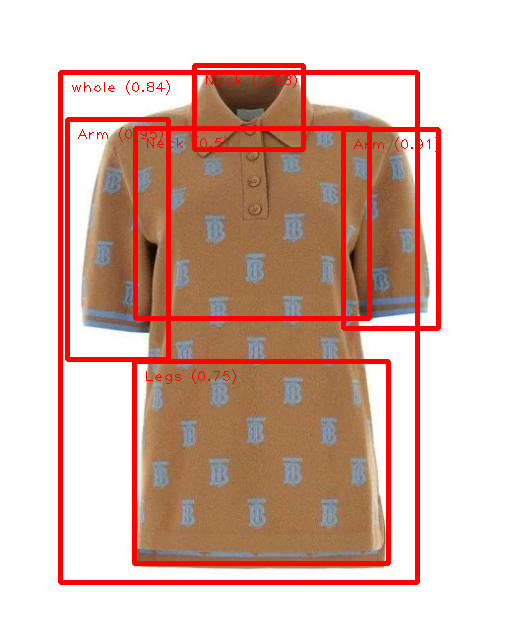

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/legsWidthSkirt8_07_jpeg.rf.68239fdc2c399dec59b5115a27075478.jpg


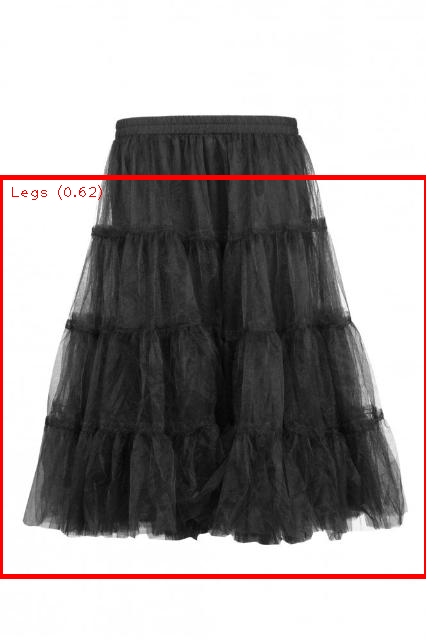

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shorts46_jpeg.rf.dd6f2fad58ff43630746760c7d7987c6.jpg


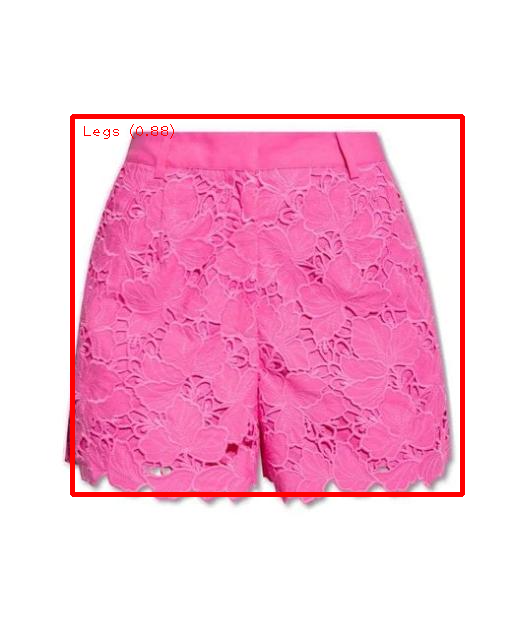

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/shoulder8_02_jpg.rf.c46ef35ef0ead340b9f38a02a51c388b.jpg


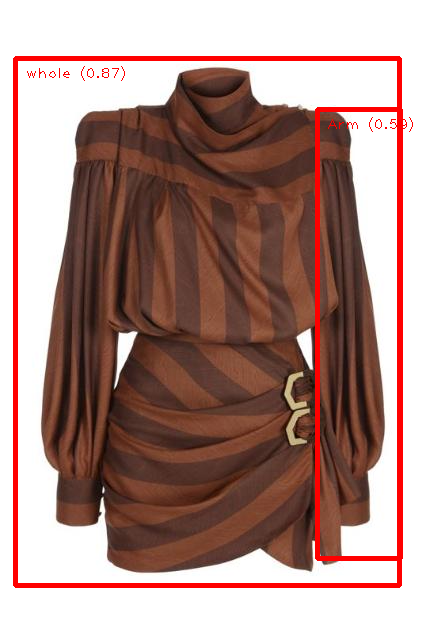

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/Neck8_02_png.rf.142fd16f6706658c2c23cc342e07cd36.jpg


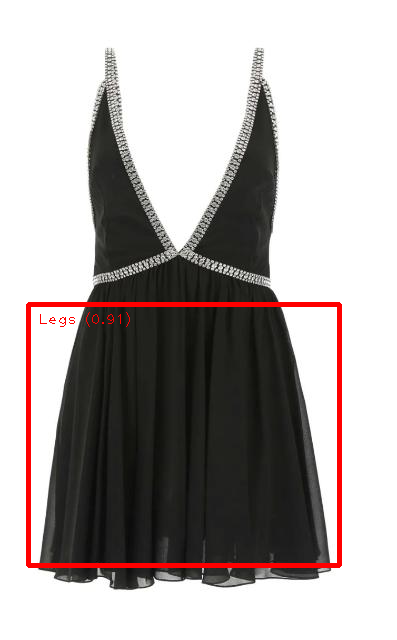

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/pants99_jpeg.rf.8aa98ee3782aeac8af075b4760e11a26.jpg


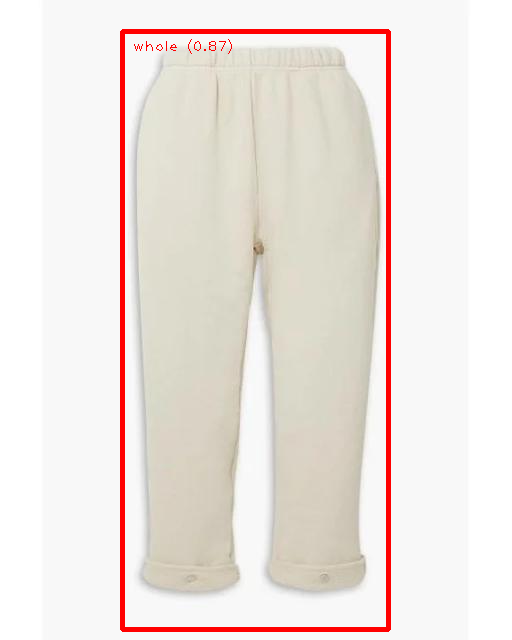

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/tops91_jpeg.rf.a36550e588d2e2f84037796c737e549f.jpg


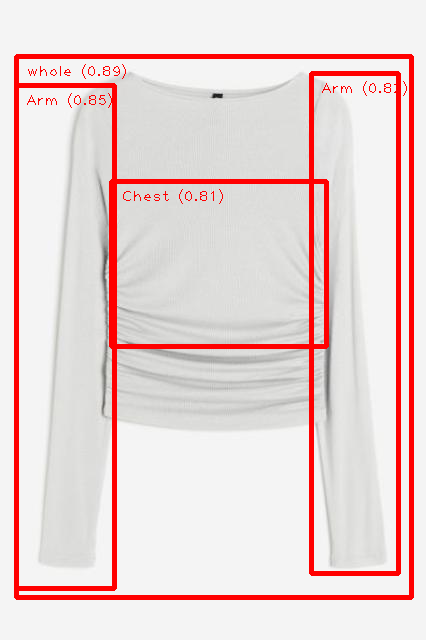

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/skirt48_jpeg.rf.cb32523cd321c153d2e1aa42f7ae889a.jpg


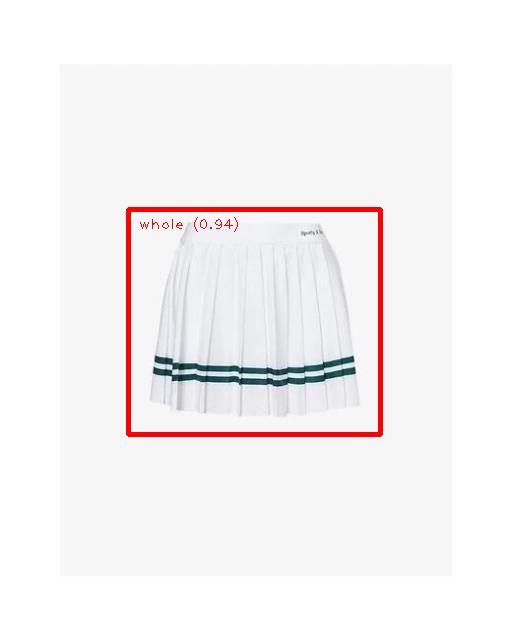

/content/drive/MyDrive/ObjectDetection/SmartFashion/ClothingPartDetection/Data_1ArmNew/test/images/jumpsuit4_jpeg.rf.14b9432c700fb827f2ade2ec8b89db91.jpg


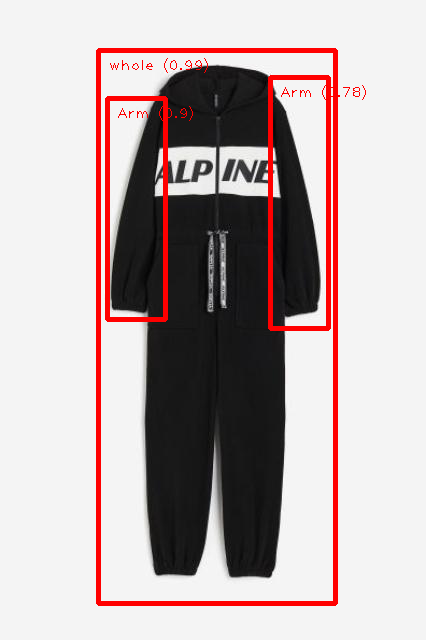

In [ ]:
import pathlib

# go to the test_directory and create array of image_filenames_array of the files in that directory
data_dir = pathlib.Path(test_dir + "/images")
print(data_dir)
image_filenames_array = list(data_dir.glob('*'))
print(image_filenames_array)
for image_filename in image_filenames_array:
  print(image_filename)

  # STEP 3: Load the input image.
  image = mp.Image.create_from_file(str(image_filename))

  # STEP 4: Detect objects in the input image.
  detection_result = detector.detect(image)

  # STEP 5: Process the detection result. In this case, visualize it.
  image_copy = np.copy(image.numpy_view())
  annotated_image = visualize(image_copy, detection_result)
  rgb_annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
  cv2_imshow(rgb_annotated_image)


##**STEP 10.4 OPTION PREDICTION ON A DATASET** (here the previously defined validation_data  (step 2)

### Plot results of running validation dataset through predicitons ---each time you run cell it takes 9 new images from the validation dataset (validation_data)


### create a [tf.data.Datset](https://www.tensorflow.org/api_docs/python/tf/data/Dataset) from the validation_data ([object_detector.Dataset](https://developers.google.com/mediapipe/api/solutions/python/mediapipe_model_maker/object_detector/Dataset#gen_tf_dataset) )

In [ ]:
print("validation_data size: ", validation_data.size)
print("size ", validation_data.__len__())

validation_data size:  106
size  106


In [ ]:
validation_tf_data_Dataset = validation_data.gen_tf_dataset(batch_size= 4)
num_elements = tf.data.experimental.cardinality(validation_tf_data_Dataset).numpy()
#validation_tf_data_Dataset.__len__()
print("validation_tf_data_Dataset size: ", num_elements)



image_ds = validation_tf_data_Dataset.list_files('*/*', shuffle=False)
for file in image_ds.take(50):
  print(file.numpy())


validation_tf_data_Dataset size:  -2
b'./.config/.last_opt_in_prompt.yaml'
b'./.config/.last_survey_prompt.yaml'
b'./.config/.last_update_check.json'
b'./.config/active_config'
b'./.config/config_sentinel'
b'./.config/configurations'
b'./.config/default_configs.db'
b'./.config/gce'
b'./.config/logs'
b'./drive/.Trash-0'
b'./drive/.file-revisions-by-id'
b'./drive/.shortcut-targets-by-id'
b'./drive/MyDrive'
b'./sample_data/README.md'
b'./sample_data/anscombe.json'
b'./sample_data/california_housing_test.csv'
b'./sample_data/california_housing_train.csv'
b'./sample_data/mnist_test.csv'
b'./sample_data/mnist_train_small.csv'


In [ ]:
# grab one batch of data from val_ds dataset
mini_dataset = validation_tf_data_Dataset.take(1)
print(mini_dataset)


<_TakeDataset element_spec={'source_id': TensorSpec(shape=(None,), dtype=tf.string, name=None), 'image': TensorSpec(shape=(None, None, None, 3), dtype=tf.uint8, name=None), 'height': TensorSpec(shape=(None,), dtype=tf.int64, name=None), 'width': TensorSpec(shape=(None,), dtype=tf.int64, name=None), 'groundtruth_classes': TensorSpec(shape=(None, None), dtype=tf.int64, name=None), 'groundtruth_is_crowd': TensorSpec(shape=(None, None), dtype=tf.bool, name=None), 'groundtruth_area': TensorSpec(shape=(None, None), dtype=tf.float32, name=None), 'groundtruth_boxes': TensorSpec(shape=(None, None, 4), dtype=tf.float32, name=None)}>


In [ ]:
list_dataset = mini_dataset.list_files('*.*')
print(list_dataset)
for i in list_dataset:
  print(i)

In [ ]:
list_dataset = mini_dataset.list_files('*.jpg')
print(list_dataset)
for i in list_dataset:
  print(i)
  #convert tensor to string and ignore the first 4 characters which have b'./ in it
  image_filename = str(i.numpy())
  image_filename = image_filename[4:]
  print(image_filename)
  image_filename = validation_dir + "/images/" + image_filename
  print(image_filename)

In [ ]:
list_dataset = mini_dataset.list_files('*.jpg')
print(list_dataset)
for i in list_dataset:
  print(i)
  #convert tensor to string and ignore the first 4 characters which have b'./ in it
  image_filename = str(i.numpy())
  image_filename = image_filename[4:]
  print(image_filename)
  image_filename = validation_dir + "/images/" + image_filename
  print(image_filename)
  # STEP 3: Load the input image.
  image = mp.Image.create_from_file(image_filename)

  # STEP 4: Detect objects in the input image.
  detection_result = detector.detect(image)

  # STEP 5: Process the detection result. In this case, visualize it.
  image_copy = np.copy(image.numpy_view())
  annotated_image = visualize(image_copy, detection_result)
  rgb_annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
  cv2_imshow(rgb_annotated_image)





In [ ]:
  image_filename = i.toString()
  print(image_filename)
  # STEP 3: Load the input image.
  image = mp.Image.create_from_file(i)

  # STEP 4: Detect objects in the input image.
  detection_result = detector.detect(image)

  # STEP 5: Process the detection result. In this case, visualize it.
  image_copy = np.copy(image.numpy_view())
  annotated_image = visualize(image_copy, detection_result)
  rgb_annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
  cv2_imshow(rgb_annotated_image)

In [ ]:
list_dataset = mini_dataset.list_files("*.jpg")
print(list_dataset)
for element in list_dataset.as_numpy_iterator():
  print(element)


In [ ]:
# grab one batch of data from val_ds dataset
mini_dataset = validation_tf_data_Dataset.take(1)
print(mini_dataset)
for images, labels in validation_tf_data_Dataset.take(1):
  #cycle through first 3 images in dataset
  for i in range(9):
    #get truth label (index value) and corresponding class name
    true_label = labels[i]
    true_class = class_names[labels[i]]
    print("Truth Class = " +true_class)

    #grab the image as an array
    img_array = tf.expand_dims(images[i], 0) # Create a batch

    #run image through prediction
    prediction_vector = model.predict(img_array)

    #print out prediction vector (output of model)
    print("Prediciton")
    print(prediction_vector)


    #get the predicted class as equal to the class name associated with the index of the maximum value in the prediction_vector
    # The sum of all outputs generated by softmax is 1 --- we have to do this as our model's output layer is not a softmax layer
    # so, we convert predicted_vector so that the sum of elements is equal to 1  (and each element ranges from 0 to 1)
    # this is the intuitive idea of a confidence probability value
    score = tf.nn.softmax(prediction_vector[0])
    print("Normalized prediction")
    print(score)
    predicted_class  = class_names[np.argmax(score)]   #predicted_class is the class name associated with the maximum value in the vector

    #print out infomration about prediction
    print("Most Likely  {} with a {:.2f}% confidence."
    .format(class_names[np.argmax(score)], 100 * np.max(score)))   #scale the max value into 0 to 100% from 0 to 1
    print(" \n\n\n")



    #plot the image with title in blue if correct or red if not along with confidence as the normalized percentage 0-100%
    ax = plt.subplot(3, 3, i + 1)

    plt.imshow(images[i].numpy().astype("uint8"))



    if predicted_class == true_class:
      color = 'blue'
    else:
       color = 'red'
    plt.axis("off")
    plt.title("{} {:2.2f}% ({})".format(predicted_class,
                                100*np.max(score),
                                true_class),
                                color=color, fontsize=7)
